# Install ultralytics



1.   Download zip folder called 'test_imgs.zip' and place it in /content directory on google colab
2.   Run all below Instructions



In [ ]:
!unzip test_imgs.zip

In [ ]:
!pip install ultralytics
!pip install ultralytics opencv-python matplotlib
# https://colab.research.google.com/github/cedro3/others/blob/master/VideoPose3D.ipynb for turning 2d yolo points to 3d in a video


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 974.5/974.5 kB 22.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 97.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 73.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 76.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

# Download an Example Image

In [ ]:
import urllib.request

url = "https://ultralytics.com/images/bus.jpg"  # Image with people
urllib.request.urlretrieve(url, "people.jpg")


('people.jpg', <http.client.HTTPMessage at 0x78f39026c390>)

#  Run YOLOv8 Pose Model

In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Load the YOLOv8 pose model
model = YOLO("yolov8n-pose.pt")

# Load the image
img = cv2.imread("people.jpg")

# Inference
results = model(img)
res = results[0]

boxes = res.boxes.xyxy.cpu().numpy()
keypoints = res.keypoints.xy.cpu().numpy()
confidences = res.keypoints.conf.cpu().numpy()

# COCO-style keypoint connections
skeleton = [
    (5, 7), (7, 9),       # left arm
    (6, 8), (8, 10),      # right arm
    (11, 13), (13, 15),   # left leg
    (12, 14), (14, 16),   # right leg
    (5, 6),               # shoulders
    (11, 12),             # hips
    (5, 11), (6, 12),     # torso diagonal
    (0, 1), (1, 2), (2, 3), (3, 4),  # head
]

for idx, (box, kp, conf) in enumerate(zip(boxes, keypoints, confidences)):
    x1, y1, x2, y2 = box.astype(int)

    # Label person
    label = f"Person {idx + 1}"
    cv2.putText(img, label, (x1, y1 - 10),
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)

    # Draw keypoints
    for i, (x, y) in enumerate(kp):
        if conf[i] > 0.5:  # draw only confident keypoints
            cv2.circle(img, (int(x), int(y)), 3, (0, 0, 255), -1)

    # Draw skeleton lines
    for i, j in skeleton:
        if conf[i] > 0.5 and conf[j] > 0.5:
            pt1 = tuple(map(int, kp[i]))
            pt2 = tuple(map(int, kp[j]))
            cv2.line(img, pt1, pt2, (255, 0, 0), 2)

# Save and show the result
cv2.imwrite("yolo_pose_skeleton.jpg", img)
cv2_imshow(img)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.52M/6.52M [00:00<00:00, 107MB/s]

WARNING ⚠️ 'source' is missing. Using 'source=/usr/local/lib/python3.11/dist-packages/ultralytics/assets'.



image 1/2 /usr/local/lib/python3.11/dist-packages/ultralytics/assets/bus.jpg: 640x480 4 persons, 382.0ms
image 2/2 /usr/local/lib/python3.11/dist-packages/ultralytics/assets/zidane.jpg: 384x640 2 persons, 165.7ms
Speed: 10.0ms preprocess, 273.8ms inference, 18.6ms postprocess per image at shape (1, 3, 384, 640)


error: OpenCV(4.11.0) /io/opencv/modules/imgcodecs/src/loadsave.cpp:929: error: (-215:Assertion failed) !_img.empty() in function 'imwrite'


# Find Output

In [ ]:
# For one image, one result
res = results[0]

# Bounding boxes
boxes = res.boxes.xyxy.cpu().numpy()

# Keypoints (x, y)
keypoints = res.keypoints.xy.cpu().numpy()  # shape: (num_people, 17, 2)

# Confidence for each keypoint
confidences = res.keypoints.conf.cpu().numpy()  # shape: (num_people, 17)

for i, (person_kps, person_conf) in enumerate(zip(keypoints, confidences)):
    print(f"\n🧍 Person {i+1}:")
    for j, ((x, y), c) in enumerate(zip(person_kps, person_conf)):
        print(f"  Keypoint {j}: x={x:.1f}, y={y:.1f}, confidence={c:.2f}")



🧍 Person 1:
  Keypoint 0: x=143.8, y=443.5, confidence=0.98
  Keypoint 1: x=149.1, y=435.2, confidence=0.90
  Keypoint 2: x=133.7, y=434.7, confidence=0.97
  Keypoint 3: x=0.0, y=0.0, confidence=0.42
  Keypoint 4: x=107.3, y=439.0, confidence=0.88
  Keypoint 5: x=163.2, y=494.3, confidence=0.99
  Keypoint 6: x=88.7, y=496.4, confidence=0.99
  Keypoint 7: x=191.3, y=561.6, confidence=0.94
  Keypoint 8: x=115.7, y=572.1, confidence=0.98
  Keypoint 9: x=157.4, y=537.6, confidence=0.91
  Keypoint 10: x=149.5, y=565.3, confidence=0.97
  Keypoint 11: x=156.2, y=641.2, confidence=1.00
  Keypoint 12: x=98.2, y=642.8, confidence=1.00
  Keypoint 13: x=182.2, y=750.8, confidence=0.99
  Keypoint 14: x=90.5, y=759.1, confidence=1.00
  Keypoint 15: x=189.3, y=852.2, confidence=0.96
  Keypoint 16: x=72.6, y=867.0, confidence=0.98

🧍 Person 2:
  Keypoint 0: x=0.0, y=0.0, confidence=0.25
  Keypoint 1: x=0.0, y=0.0, confidence=0.29
  Keypoint 2: x=0.0, y=0.0, confidence=0.08
  Keypoint 3: x=0.0, y=0.0,

# Trying with Man with a gun

Image: r2ya_9.png, Size: (398, 413)

image 1/1 /content/test_imgs/r2ya_9.png: 640x640 1 person, 245.9ms
Speed: 16.2ms preprocess, 245.9ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


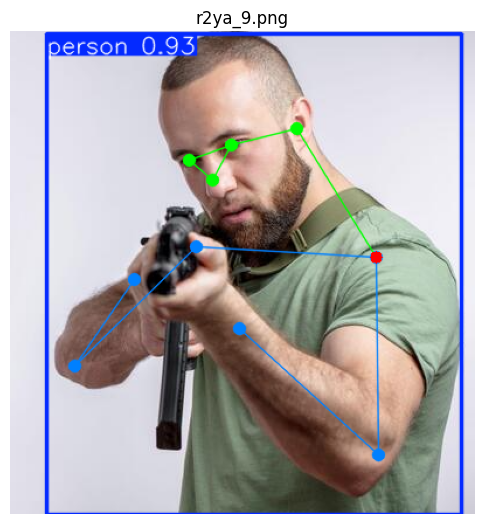

Left Shoulder: [     313.12      193.58]
Right Shoulder: [     159.38      184.93]
Left Elbow: [     315.29      362.02]
Right Elbow: [     55.339      286.63]
Left Wrist: [      196.9      254.87]
Right Wrist: [     106.44      212.99]
Left Eye: [     189.53      97.236]
Right Eye: [     153.47      110.24]
Left Ear: [      245.9      83.214]
Right Ear: [          0           0]
x, y:  313.1153   193.58089
l_arm_exists:  True  l_angle:  47.114662
r_arm_exists:  True  r_angle:  10.894262
pre one_hand:  False
RIFLE
wrists_width:  99.67858
shoulders_width:  153.98062
Testing for threat level 3
THREAT LEVEL 3
Image: r2ya_8.png, Size: (706, 550)

image 1/1 /content/test_imgs/r2ya_8.png: 512x640 1 person, 221.0ms
Speed: 6.8ms preprocess, 221.0ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)


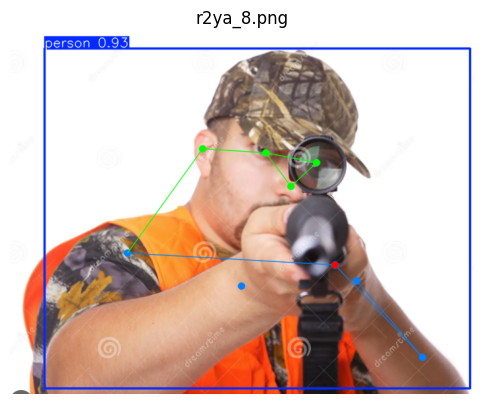

Left Shoulder: [     493.91      354.49]
Right Shoulder: [     178.13       336.4]
Left Elbow: [     626.31       494.1]
Right Elbow: [          0           0]
Left Wrist: [     526.71         379]
Right Wrist: [     351.32      386.18]
Left Eye: [     465.13      199.85]
Right Eye: [      388.4      184.43]
Left Ear: [          0           0]
Right Ear: [     292.44      178.11]
x, y:  493.90973   354.49155
l_arm_exists:  True  l_angle:  2.611345
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
RIFLE
wrists_width:  175.53076
shoulders_width:  316.29388
Testing for threat level 3
THREAT LEVEL 2
Image: r2ya_7.png, Size: (647, 479)

image 1/1 /content/test_imgs/r2ya_7.png: 480x640 1 person, 186.8ms
Speed: 4.4ms preprocess, 186.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


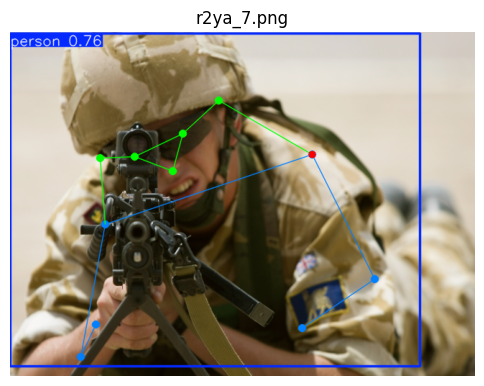

Left Shoulder: [     420.47      171.09]
Right Shoulder: [     132.62       268.9]
Left Elbow: [     507.14       344.9]
Right Elbow: [     98.427      452.62]
Left Wrist: [     406.99      412.58]
Right Wrist: [      119.3      407.97]
Left Eye: [     240.43      142.29]
Right Eye: [     173.22      174.78]
Left Ear: [     290.05       96.65]
Right Ear: [     125.03      176.04]
x, y:  420.46692   171.09058
l_arm_exists:  True  l_angle:  97.54576
r_arm_exists:  True  r_angle:  14.518485
pre one_hand:  False
RIFLE
wrists_width:  287.7272
shoulders_width:  304.0138
THREAT LEVEL 2, r1
Image: r2ya_6.png, Size: (494, 791)

image 1/1 /content/test_imgs/r2ya_6.png: 640x416 1 person, 185.2ms
Speed: 5.5ms preprocess, 185.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 416)


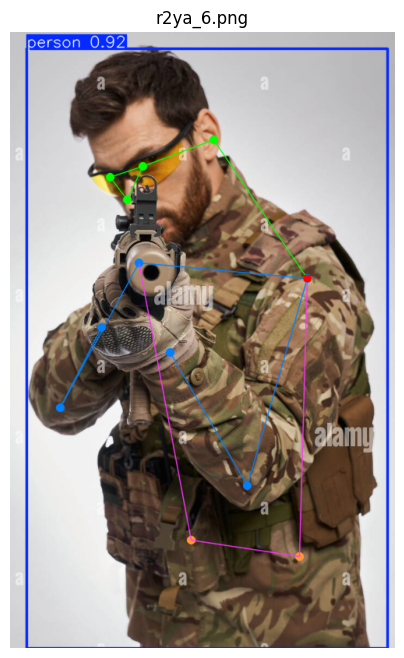

Left Shoulder: [     381.77      316.45]
Right Shoulder: [     165.96      296.66]
Left Elbow: [     304.52      582.41]
Right Elbow: [     64.869      482.47]
Left Wrist: [     205.21      411.86]
Right Wrist: [     117.84      379.99]
Left Eye: [     170.59      172.08]
Right Eye: [     128.43       186.9]
Left Ear: [     261.45      138.28]
Right Ear: [          0           0]
x, y:  381.7748   316.45016
l_arm_exists:  True  l_angle:  46.407864
r_arm_exists:  True  r_angle:  1.2125688
pre one_hand:  False
RIFLE
wrists_width:  93.00064
shoulders_width:  216.72421
Testing for threat level 3
THREAT LEVEL 3
Image: r2ya_5.png, Size: (477, 479)

image 1/1 /content/test_imgs/r2ya_5.png: 640x640 1 person, 283.6ms
Speed: 5.2ms preprocess, 283.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


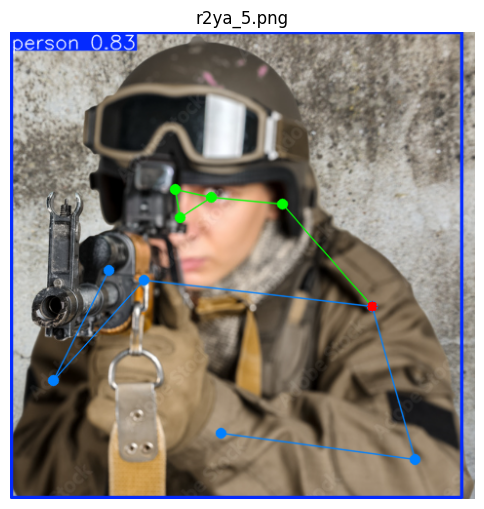

Left Shoulder: [        371      281.54]
Right Shoulder: [     137.57      254.79]
Left Elbow: [     415.66      438.97]
Right Elbow: [     44.432      357.09]
Left Wrist: [     216.49      411.87]
Right Wrist: [     101.78      244.77]
Left Eye: [      206.6      169.45]
Right Eye: [     169.49      161.99]
Left Ear: [     279.18       176.7]
Right Ear: [          0           0]
x, y:  371.00134   281.53696
l_arm_exists:  True  l_angle:  66.41588
r_arm_exists:  True  r_angle:  15.269519
pre one_hand:  False
RIFLE
wrists_width:  202.68372
shoulders_width:  234.95589
THREAT LEVEL 2, r1
Image: r2ya_4.png, Size: (409, 599)

image 1/1 /content/test_imgs/r2ya_4.png: 640x448 1 person, 244.0ms
Speed: 5.3ms preprocess, 244.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 448)


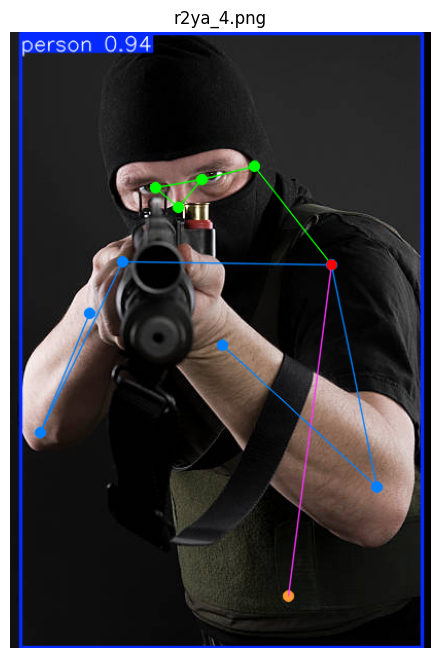

Left Shoulder: [     312.17      226.84]
Right Shoulder: [     109.95      223.72]
Left Elbow: [     356.83      442.56]
Right Elbow: [     29.432      389.16]
Left Wrist: [     206.38      304.49]
Right Wrist: [      77.29      273.21]
Left Eye: [     186.47      143.86]
Right Eye: [     141.28      151.06]
Left Ear: [     237.85      130.65]
Right Ear: [          0           0]
x, y:  312.1729   226.83615
l_arm_exists:  True  l_angle:  35.761517
r_arm_exists:  True  r_angle:  3.525534
pre one_hand:  False
RIFLE
wrists_width:  132.82898
shoulders_width:  202.24281
Testing for threat level 3
THREAT LEVEL 3
Image: r2ya_3.png, Size: (551, 863)

image 1/1 /content/test_imgs/r2ya_3.png: 640x416 1 person, 189.3ms
Speed: 4.1ms preprocess, 189.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 416)


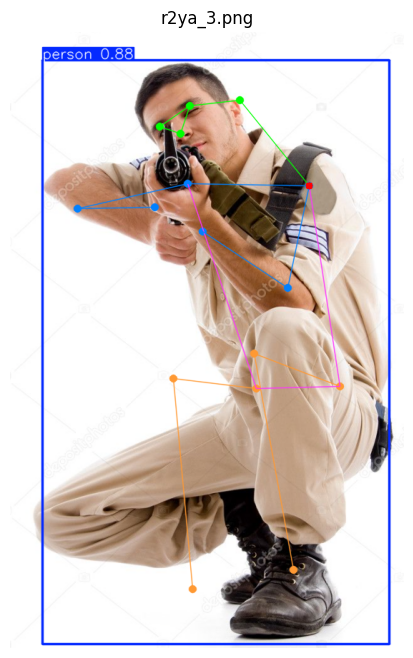

Left Shoulder: [     418.13      215.41]
Right Shoulder: [     248.47      212.65]
Left Elbow: [     388.56       358.1]
Right Elbow: [     94.978      247.08]
Left Wrist: [     269.18      279.77]
Right Wrist: [     202.17       245.7]
Left Eye: [     251.77      103.23]
Right Eye: [     209.87       132.9]
Left Ear: [      321.2      95.365]
Right Ear: [          0           0]
x, y:  418.13467   215.41306
l_arm_exists:  True  l_angle:  68.440186
r_arm_exists:  True  r_angle:  11.904993
pre one_hand:  False
RIFLE
wrists_width:  75.17238
shoulders_width:  169.69128
Testing for threat level 3
THREAT LEVEL 3
Image: r2ya_2.png, Size: (530, 496)

image 1/1 /content/test_imgs/r2ya_2.png: 608x640 1 person, 279.7ms
Speed: 5.3ms preprocess, 279.7ms inference, 1.1ms postprocess per image at shape (1, 3, 608, 640)


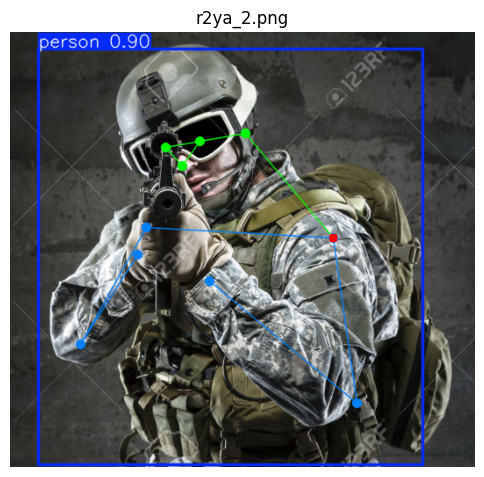

Left Shoulder: [      368.7      235.03]
Right Shoulder: [     155.61      223.41]
Left Elbow: [     395.94      423.49]
Right Elbow: [     80.829      356.25]
Left Wrist: [     227.57      284.28]
Right Wrist: [      145.4      254.22]
Left Eye: [     216.08      125.27]
Right Eye: [     177.67      132.62]
Left Ear: [     268.91       116.9]
Right Ear: [          0           0]
x, y:  368.70093   235.02672
l_arm_exists:  True  l_angle:  42.19071
r_arm_exists:  True  r_angle:  2.9490223
pre one_hand:  False
RIFLE
wrists_width:  87.49108
shoulders_width:  213.40303
Testing for threat level 3
THREAT LEVEL 3
Image: r2ya_11.png, Size: (405, 382)

image 1/1 /content/test_imgs/r2ya_11.png: 608x640 1 person, 297.1ms
Speed: 9.0ms preprocess, 297.1ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)


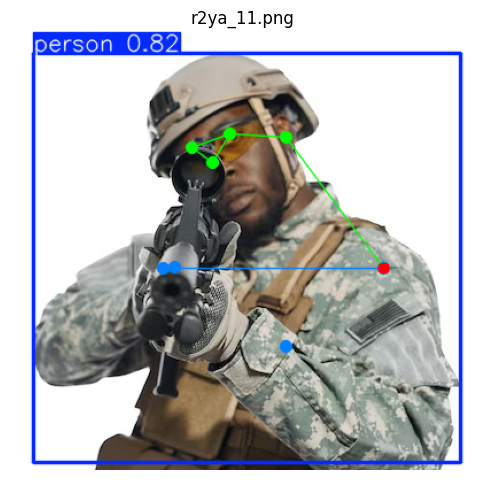

Left Shoulder: [     325.71      206.08]
Right Shoulder: [     133.35      206.75]
Left Elbow: [          0           0]
Right Elbow: [          0           0]
Left Wrist: [     240.72      274.92]
Right Wrist: [     143.52      205.25]
Left Eye: [     191.53       89.59]
Right Eye: [     158.94      101.58]
Left Ear: [     240.77      92.981]
Right Ear: [          0           0]
x, y:  325.71323   206.07776
l_arm_exists:  False  l_angle:  None
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
RIFLE
wrists_width:  119.5894
shoulders_width:  192.36357
Testing for threat level 3
THREAT LEVEL 3
Image: r2ya_10.png, Size: (599, 926)

image 1/1 /content/test_imgs/r2ya_10.png: 640x416 1 person, 212.4ms
Speed: 4.0ms preprocess, 212.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 416)


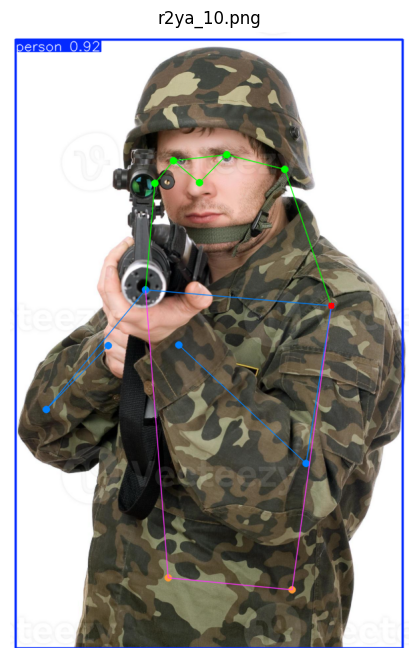

Left Shoulder: [     482.47      411.12]
Right Shoulder: [     203.96      387.12]
Left Elbow: [     444.42      648.15]
Right Elbow: [     54.281      567.33]
Left Wrist: [     253.14      470.86]
Right Wrist: [     147.67      471.56]
Left Eye: [        326      184.97]
Right Eye: [      245.1      193.09]
Left Ear: [     412.12      206.32]
Right Ear: [     217.09      227.42]
x, y:  482.4739   411.12225
l_arm_exists:  True  l_angle:  56.294376
r_arm_exists:  True  r_angle:  4.564886
pre one_hand:  False
RIFLE
wrists_width:  105.4702
shoulders_width:  279.5459
Testing for threat level 3
THREAT LEVEL 3
Image: r2ya_1.png, Size: (210, 299)

image 1/1 /content/test_imgs/r2ya_1.png: 640x480 1 person, 261.0ms
Speed: 3.6ms preprocess, 261.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 480)


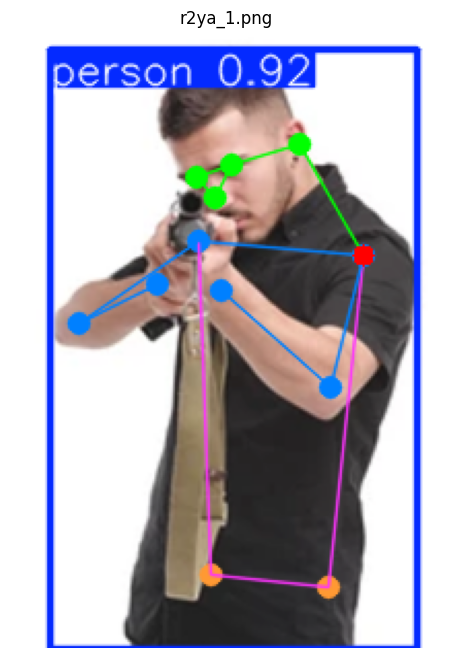

Left Shoulder: [     171.52      108.26]
Right Shoulder: [     91.458       101.3]
Left Elbow: [     155.45      172.34]
Right Elbow: [     33.152      141.16]
Left Wrist: [     102.53      125.05]
Right Wrist: [     71.162      122.16]
Left Eye: [     107.83      64.869]
Right Eye: [     90.238      70.855]
Left Ear: [     140.43      54.398]
Right Ear: [          0           0]
x, y:  171.51656   108.25641
l_arm_exists:  True  l_angle:  62.293438
r_arm_exists:  True  r_angle:  7.791729
pre one_hand:  False
RIFLE
wrists_width:  31.503725
shoulders_width:  80.35979
Testing for threat level 3
THREAT LEVEL 3
Image: r2na_9.png, Size: (369, 284)

image 1/1 /content/test_imgs/r2na_9.png: 512x640 1 person, 237.5ms
Speed: 4.1ms preprocess, 237.5ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)


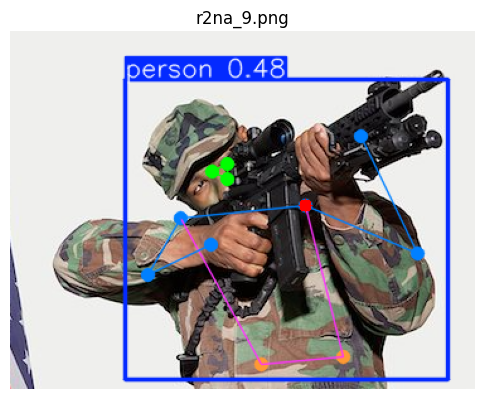

Left Shoulder: [     234.76      138.74]
Right Shoulder: [     135.77      148.34]
Left Elbow: [     323.01      176.55]
Right Elbow: [      109.3      193.24]
Left Wrist: [     278.16      83.792]
Right Wrist: [     159.22      169.46]
Left Eye: [     172.96      105.52]
Right Eye: [     160.35      111.35]
Left Ear: [          0           0]
Right Ear: [          0           0]
x, y:  234.76343   138.74414
l_arm_exists:  True  l_angle:  41.00601
r_arm_exists:  True  r_angle:  34.009846
pre one_hand:  False
RIFLE
wrists_width:  146.57921
shoulders_width:  99.459145
THREAT LEVEL 2, r1
Image: r2na_8.png, Size: (406, 546)

image 1/1 /content/test_imgs/r2na_8.png: 640x480 1 person, 258.2ms
Speed: 4.2ms preprocess, 258.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 480)


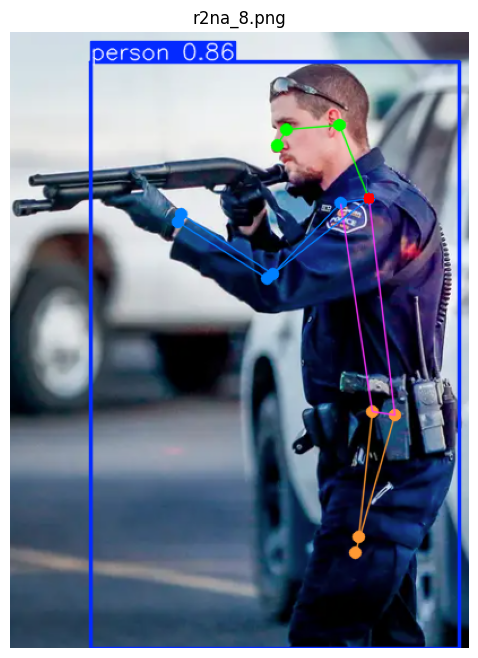

Left Shoulder: [     317.76      147.65]
Right Shoulder: [     292.46      151.11]
Left Elbow: [     227.43      218.99]
Right Elbow: [     232.68      214.82]
Left Wrist: [     148.43      168.42]
Right Wrist: [     151.35      161.97]
Left Eye: [     244.52      86.391]
Right Eye: [          0           0]
Left Ear: [     291.46      82.941]
Right Ear: [          0           0]
x, y:  317.7626   147.64597
l_arm_exists:  True  l_angle:  109.077065
r_arm_exists:  True  r_angle:  100.152885
pre one_hand:  False
RIFLE
wrists_width:  7.083857
shoulders_width:  25.542755
THREAT LEVEL 2, r2
Image: r2na_7.png, Size: (466, 681)

image 1/1 /content/test_imgs/r2na_7.png: 640x448 1 person, 283.0ms
Speed: 4.9ms preprocess, 283.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 448)


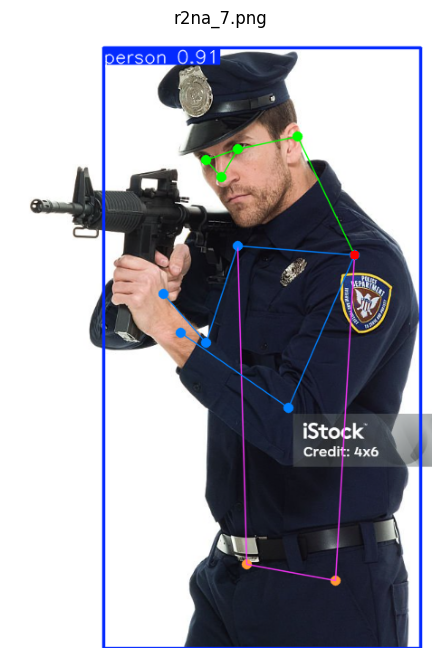

Left Shoulder: [     380.94      246.54]
Right Shoulder: [     251.83      236.69]
Left Elbow: [     307.15      415.36]
Right Elbow: [     216.97      343.88]
Left Wrist: [     188.61      332.08]
Right Wrist: [     169.92      289.12]
Left Eye: [     251.92      129.56]
Right Eye: [     216.17      141.44]
Left Ear: [     317.16      115.71]
Right Ear: [          0           0]
x, y:  380.9369   246.53905
l_arm_exists:  True  l_angle:  78.52058
r_arm_exists:  True  r_angle:  58.680687
pre one_hand:  False
RIFLE
wrists_width:  46.850315
shoulders_width:  129.48514
THREAT LEVEL 2, r2
Image: r2na_6.png, Size: (548, 422)

image 1/1 /content/test_imgs/r2na_6.png: 512x640 1 person, 344.3ms
Speed: 4.7ms preprocess, 344.3ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 640)


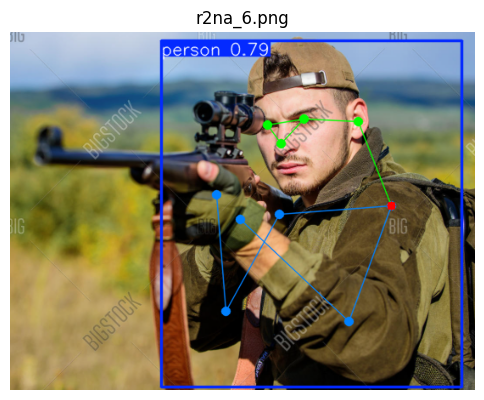

Left Shoulder: [     449.08      205.15]
Right Shoulder: [      317.9      215.68]
Left Elbow: [      399.1      341.31]
Right Elbow: [     254.53      329.28]
Left Wrist: [     271.16      221.37]
Right Wrist: [     243.56      192.03]
Left Eye: [     346.25      103.57]
Right Eye: [     303.42      110.56]
Left Ear: [     410.11      106.07]
Right Ear: [          0           0]
x, y:  449.07812   205.14883
l_arm_exists:  True  l_angle:  67.00526
r_arm_exists:  True  r_angle:  33.727375
pre one_hand:  False
RIFLE
wrists_width:  40.285408
shoulders_width:  131.5988
THREAT LEVEL 2, r2
Image: r2na_5.png, Size: (494, 510)

image 1/1 /content/test_imgs/r2na_5.png: 640x640 (no detections), 339.9ms
Speed: 5.6ms preprocess, 339.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Error opening test_imgs/r2na_5.png: index 5 is out of bounds for axis 0 with size 0
Image: r2na_4.png, Size: (643, 891)

image 1/1 /content/test_imgs/r2na_4.png: 640x480 1 person, 343.9ms
Speed: 16.7m

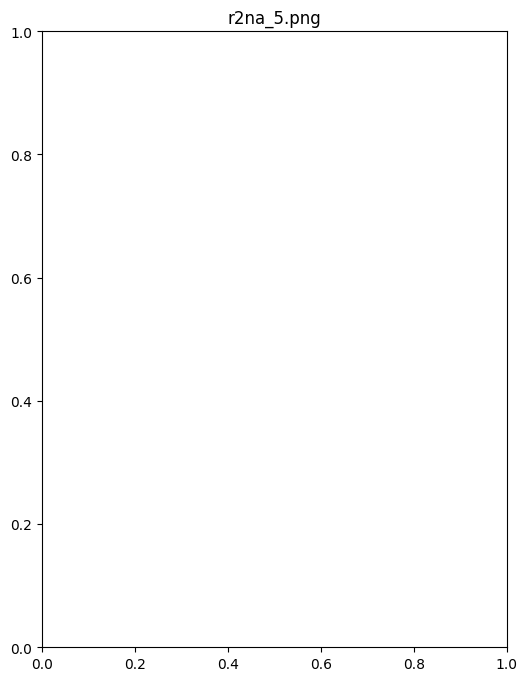

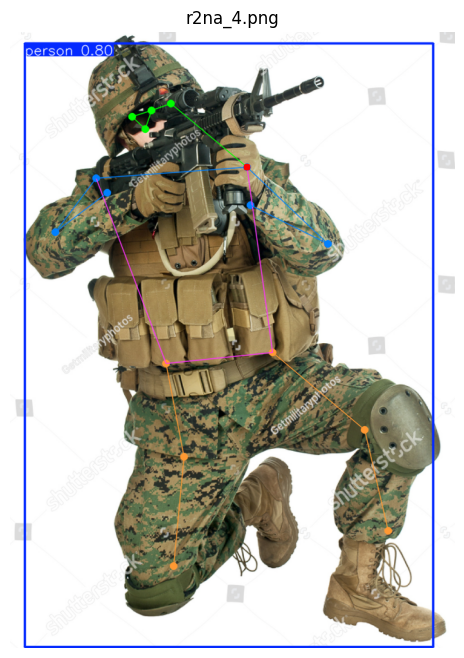

Left Shoulder: [     342.74      195.32]
Right Shoulder: [     124.85      211.14]
Left Elbow: [     459.11      306.84]
Right Elbow: [     65.992      289.13]
Left Wrist: [     347.32      250.98]
Right Wrist: [     140.47      232.93]
Left Eye: [     204.64      113.74]
Right Eye: [     176.67      122.77]
Left Ear: [     232.71      103.67]
Right Ear: [          0           0]
x, y:  342.74408   195.32318
l_arm_exists:  True  l_angle:  17.232069
r_arm_exists:  True  r_angle:  15.920352
pre one_hand:  False
RIFLE
wrists_width:  207.64012
shoulders_width:  218.46971
THREAT LEVEL 2, r1
Image: r2na_3.png, Size: (599, 467)

image 1/1 /content/test_imgs/r2na_3.png: 512x640 1 person, 278.8ms
Speed: 5.0ms preprocess, 278.8ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)


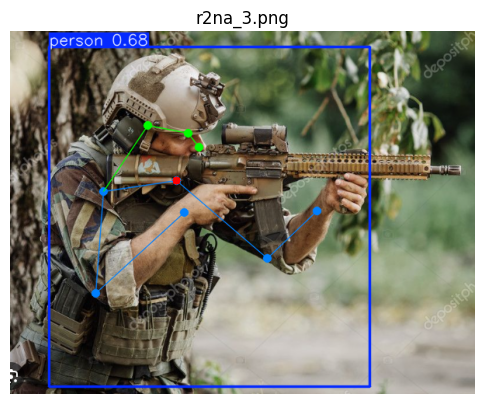

Left Shoulder: [     214.73      192.26]
Right Shoulder: [     120.36      206.74]
Left Elbow: [     331.35      292.51]
Right Elbow: [     110.97      337.46]
Left Wrist: [     395.26      231.15]
Right Wrist: [     224.86      233.37]
Left Eye: [          0           0]
Right Eye: [     229.91      131.51]
Left Ear: [          0           0]
Right Ear: [     177.91      121.64]
x, y:  214.72517   192.26282
l_arm_exists:  True  l_angle:  95.48681
r_arm_exists:  True  r_angle:  43.46706
pre one_hand:  False
RIFLE
wrists_width:  170.40697
shoulders_width:  95.470055
THREAT LEVEL 2, r1
Image: r2na_2.png, Size: (396, 652)

image 1/1 /content/test_imgs/r2na_2.png: 640x416 1 person, 240.8ms
Speed: 6.2ms preprocess, 240.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 416)


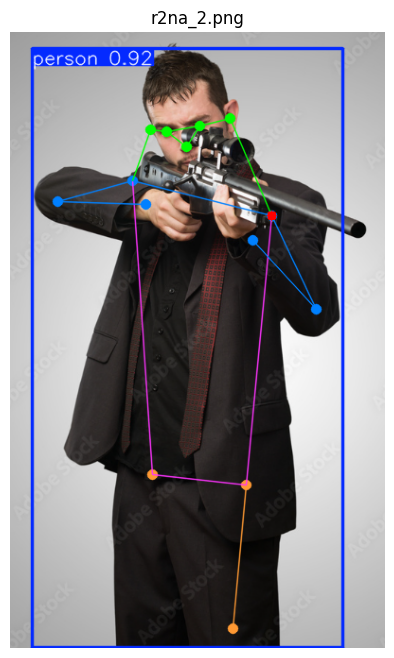

Left Shoulder: [     276.43         194]
Right Shoulder: [     129.62      157.46]
Left Elbow: [     323.91      293.43]
Right Elbow: [     50.224      179.16]
Left Wrist: [      256.8      220.81]
Right Wrist: [     143.33       182.8]
Left Eye: [     200.62      99.433]
Right Eye: [     165.15      105.11]
Left Ear: [     232.08      91.952]
Right Ear: [     148.64      103.71]
x, y:  276.42847   194.0036
l_arm_exists:  True  l_angle:  17.214342
r_arm_exists:  True  r_angle:  17.522669
pre one_hand:  False
RIFLE
wrists_width:  119.6685
shoulders_width:  151.28741
THREAT LEVEL 2, r1
Image: r2na_13.png, Size: (339, 529)

image 1/1 /content/test_imgs/r2na_13.png: 640x416 1 person, 240.7ms
Speed: 5.1ms preprocess, 240.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 416)


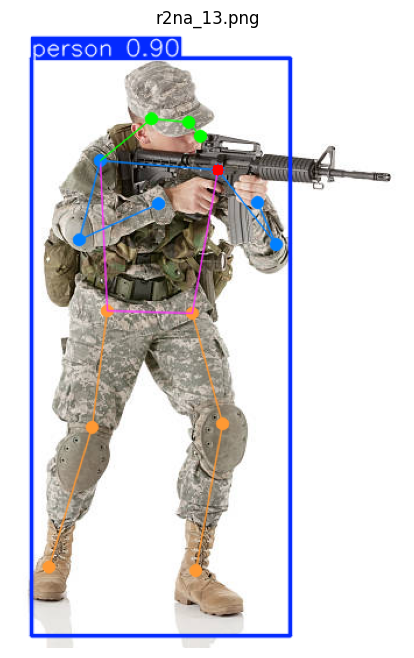

Left Shoulder: [      178.6      118.26]
Right Shoulder: [      77.57       110.2]
Left Elbow: [     228.32      182.57]
Right Elbow: [     59.212      178.21]
Left Wrist: [     212.91      146.35]
Right Wrist: [     127.32      147.23]
Left Eye: [          0           0]
Right Eye: [     153.86       77.96]
Left Ear: [          0           0]
Right Ear: [     121.37      74.565]
x, y:  178.59933   118.26234
l_arm_exists:  True  l_angle:  14.6613245
r_arm_exists:  True  r_angle:  50.4316
pre one_hand:  False
RIFLE
wrists_width:  85.591
shoulders_width:  101.35081
THREAT LEVEL 2, r1
Image: r2na_12.png, Size: (401, 590)

image 1/1 /content/test_imgs/r2na_12.png: 640x448 1 person, 286.9ms
Speed: 5.7ms preprocess, 286.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)


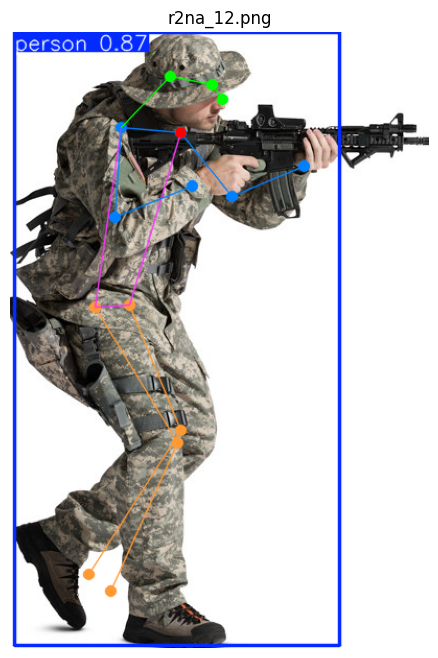

Left Shoulder: [     163.75      96.071]
Right Shoulder: [     106.83      91.807]
Left Elbow: [     212.47      157.75]
Right Elbow: [     100.47      177.62]
Left Wrist: [      281.2      128.23]
Right Wrist: [     174.58      147.57]
Left Eye: [          0           0]
Right Eye: [      193.8      50.953]
Left Ear: [          0           0]
Right Ear: [     153.35      42.728]
x, y:  163.75082   96.07079
l_arm_exists:  True  l_angle:  105.05371
r_arm_exists:  True  r_angle:  63.6875
pre one_hand:  False
RIFLE
wrists_width:  108.35818
shoulders_width:  57.078876
THREAT LEVEL 2, r1
Image: r2na_11.png, Size: (354, 375)

image 1/1 /content/test_imgs/r2na_11.png: 640x608 1 person, 339.3ms
Speed: 5.4ms preprocess, 339.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 608)


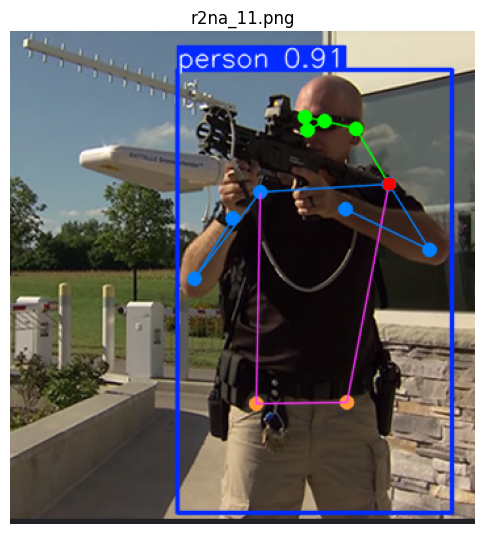

Left Shoulder: [     288.04      116.65]
Right Shoulder: [     190.34      122.29]
Left Elbow: [     319.82      166.45]
Right Elbow: [     140.58       188.9]
Left Wrist: [      255.9       135.1]
Right Wrist: [     169.52      142.72]
Left Eye: [     239.45      68.144]
Right Eye: [     224.94      65.741]
Left Ear: [     263.54      74.314]
Right Ear: [          0           0]
x, y:  288.0387   116.64914
l_arm_exists:  True  l_angle:  31.329168
r_arm_exists:  True  r_angle:  4.6908092
pre one_hand:  False
RIFLE
wrists_width:  86.71556
shoulders_width:  97.85923
THREAT LEVEL 2, r1
Image: r2na_10.png, Size: (623, 462)

image 1/1 /content/test_imgs/r2na_10.png: 480x640 1 person, 282.5ms
Speed: 5.1ms preprocess, 282.5ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


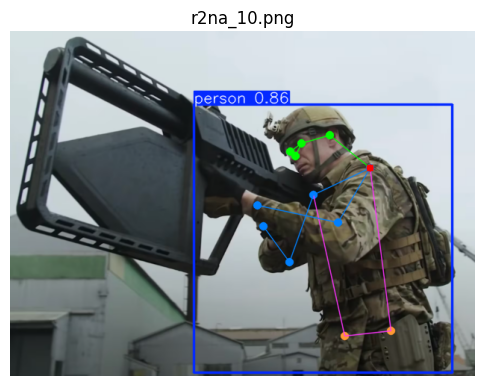

Left Shoulder: [     482.38      183.75]
Right Shoulder: [     406.98      219.95]
Left Elbow: [     439.31      256.87]
Right Elbow: [     374.52      309.39]
Left Wrist: [     331.83      233.31]
Right Wrist: [      339.9      261.17]
Left Eye: [     390.09      150.11]
Right Eye: [     375.37      161.67]
Left Ear: [     428.82      139.24]
Right Ear: [          0           0]
x, y:  482.37567   183.75417
l_arm_exists:  True  l_angle:  108.13294
r_arm_exists:  True  r_angle:  55.624557
pre one_hand:  False
RIFLE
wrists_width:  29.008259
shoulders_width:  83.63392
THREAT LEVEL 2, r2
Image: r2na_1.png, Size: (281, 213)

image 1/1 /content/test_imgs/r2na_1.png: 512x640 1 person, 288.8ms
Speed: 8.8ms preprocess, 288.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


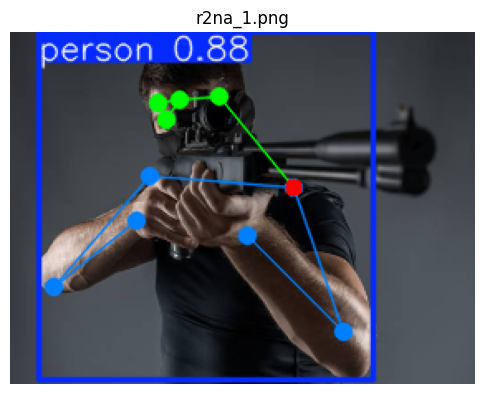

Left Shoulder: [     171.33      94.495]
Right Shoulder: [     84.288      87.016]
Left Elbow: [     201.87      181.35]
Right Elbow: [      26.24      154.52]
Left Wrist: [     143.89      123.18]
Right Wrist: [     76.057      114.31]
Left Eye: [      102.4      41.937]
Right Eye: [     89.542      43.015]
Left Ear: [     126.57       39.71]
Right Ear: [          0           0]
x, y:  171.32895   94.49511
l_arm_exists:  True  l_angle:  25.534178
r_arm_exists:  True  r_angle:  10.397257
pre one_hand:  False
RIFLE
wrists_width:  68.4094
shoulders_width:  87.36149
THREAT LEVEL 2, r1
Image: p2ya_9.png, Size: (380, 363)

image 1/1 /content/test_imgs/p2ya_9.png: 640x640 1 person, 383.4ms
Speed: 5.9ms preprocess, 383.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


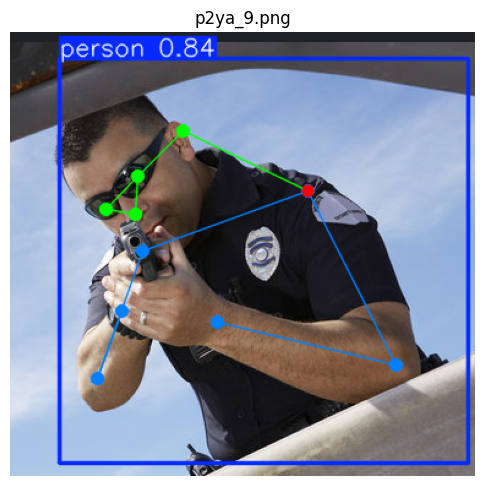

Left Shoulder: [      243.4      130.47]
Right Shoulder: [     108.05      179.11]
Left Elbow: [     315.81       272.4]
Right Elbow: [     71.013      283.87]
Left Wrist: [     169.68      237.98]
Right Wrist: [     91.848      228.48]
Left Eye: [     104.58      118.64]
Right Eye: [      78.89      145.45]
Left Ear: [     141.72      81.581]
Right Ear: [          0           0]
x, y:  243.39569   130.46524
l_arm_exists:  True  l_angle:  49.715878
r_arm_exists:  True  r_angle:  1.1412387
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2ya_8.png, Size: (583, 496)

image 1/1 /content/test_imgs/p2ya_8.png: 544x640 1 person, 296.6ms
Speed: 5.6ms preprocess, 296.6ms inference, 1.9ms postprocess per image at shape (1, 3, 544, 640)


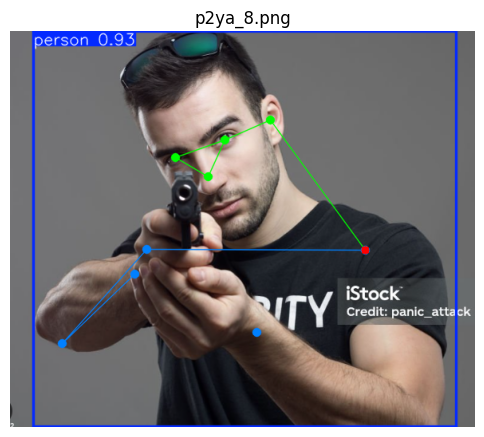

Left Shoulder: [     445.61      274.44]
Right Shoulder: [     171.41      273.16]
Left Elbow: [          0           0]
Right Elbow: [     65.564       391.6]
Left Wrist: [     309.54       377.9]
Right Wrist: [     156.73      304.99]
Left Eye: [     269.38      136.12]
Right Eye: [     207.86      158.17]
Left Ear: [      326.1      111.15]
Right Ear: [          0           0]
x, y:  445.61395   274.43875
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  4.685043
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p2ya_7.png, Size: (454, 532)

image 1/1 /content/test_imgs/p2ya_7.png: 640x576 1 person, 338.0ms
Speed: 5.7ms preprocess, 338.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 576)


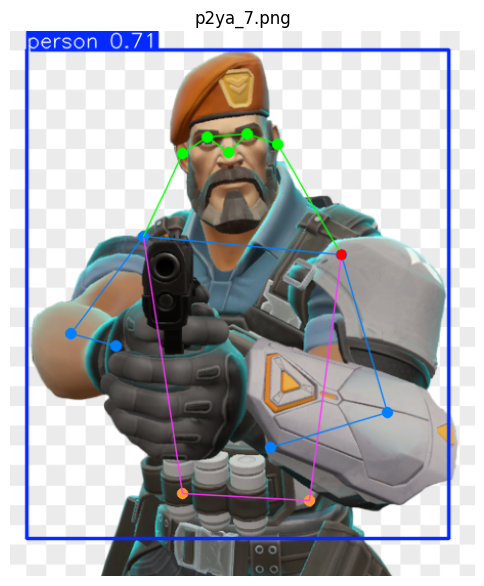

Left Shoulder: [     323.06      218.35]
Right Shoulder: [      130.8      200.28]
Left Elbow: [      368.8      372.78]
Right Elbow: [     59.492      295.27]
Left Wrist: [     254.39      406.64]
Right Wrist: [      103.2      307.35]
Left Eye: [      231.8      100.03]
Right Eye: [     192.52      103.74]
Left Ear: [     261.58      110.96]
Right Ear: [     168.19      119.32]
x, y:  323.06308   218.3472
l_arm_exists:  True  l_angle:  89.99483
r_arm_exists:  True  r_angle:  68.55385
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2ya_6.png, Size: (636, 728)

image 1/1 /content/test_imgs/p2ya_6.png: 640x576 1 person, 319.2ms
Speed: 6.3ms preprocess, 319.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 576)


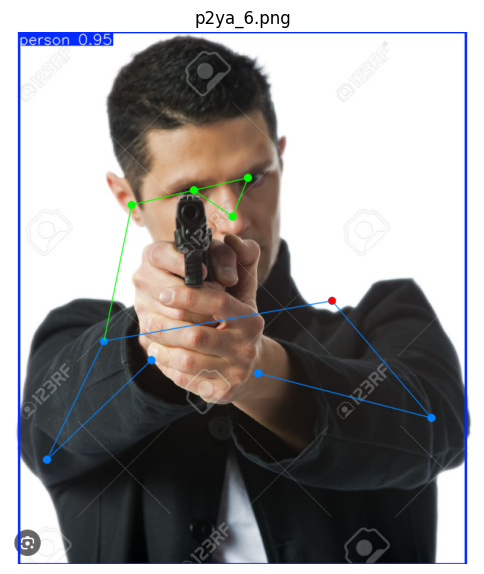

Left Shoulder: [      440.4      368.05]
Right Shoulder: [     128.35      423.68]
Left Elbow: [     576.06      528.45]
Right Elbow: [     50.259      585.13]
Left Wrist: [      339.6      467.47]
Right Wrist: [     193.16      449.24]
Left Eye: [     325.76      200.64]
Right Eye: [     251.81      217.68]
Left Ear: [          0           0]
Right Ear: [     166.11       237.7]
x, y:  440.39658   368.05173
l_arm_exists:  True  l_angle:  35.316425
r_arm_exists:  True  r_angle:  20.626879
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2ya_5.png, Size: (659, 502)

image 1/1 /content/test_imgs/p2ya_5.png: 512x640 1 person, 275.4ms
Speed: 5.8ms preprocess, 275.4ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


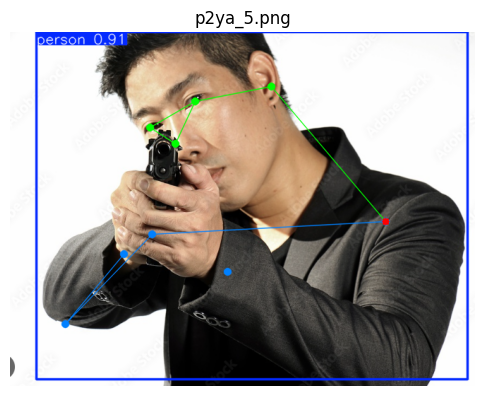

Left Shoulder: [     532.68       269.2]
Right Shoulder: [      201.1      287.31]
Left Elbow: [          0           0]
Right Elbow: [     78.314      414.76]
Left Wrist: [     308.96      340.88]
Right Wrist: [     161.03      315.18]
Left Eye: [     262.97      99.851]
Right Eye: [     198.91      136.75]
Left Ear: [     370.54      78.054]
Right Ear: [          0           0]
x, y:  532.68494   269.20334
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  4.2174687
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p2ya_4.png, Size: (401, 424)

image 1/1 /content/test_imgs/p2ya_4.png: 640x608 1 person, 343.2ms
Speed: 12.5ms preprocess, 343.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 608)


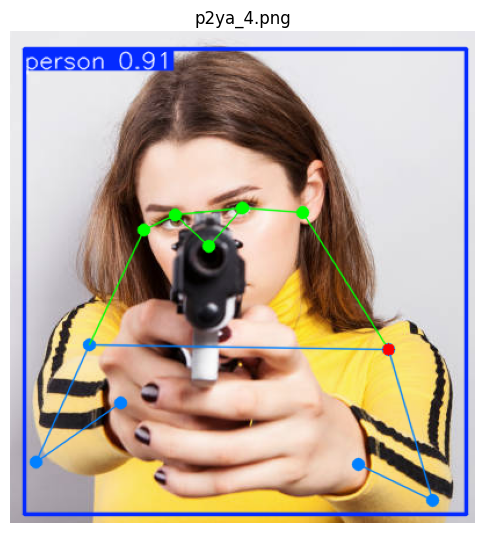

Left Shoulder: [     326.82      274.24]
Right Shoulder: [     68.542      270.56]
Left Elbow: [     364.23      404.86]
Right Elbow: [     22.944      371.31]
Left Wrist: [     300.61      373.31]
Right Wrist: [     95.535      320.24]
Left Eye: [        200       152.1]
Right Eye: [     142.88      158.87]
Left Ear: [     252.95      156.24]
Right Ear: [     115.45      171.28]
x, y:  326.81555   274.2382
l_arm_exists:  True  l_angle:  47.637268
r_arm_exists:  True  r_angle:  30.519989
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2ya_3.png, Size: (578, 861)

image 1/1 /content/test_imgs/p2ya_3.png: 640x448 1 person, 227.8ms
Speed: 4.6ms preprocess, 227.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 448)


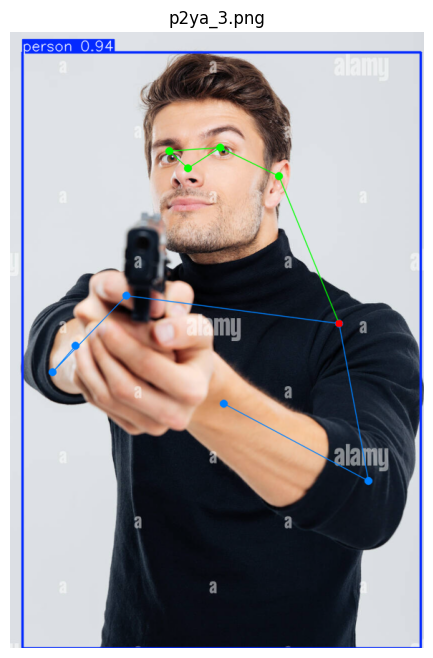

Left Shoulder: [     459.67      407.91]
Right Shoulder: [     162.77      368.24]
Left Elbow: [     500.64      627.07]
Right Elbow: [     59.012      475.33]
Left Wrist: [     298.11      519.33]
Right Wrist: [     91.954      438.37]
Left Eye: [     293.75      161.04]
Right Eye: [     222.96         167]
Left Ear: [     375.54      201.23]
Right Ear: [          0           0]
x, y:  459.67453   407.91107
l_arm_exists:  True  l_angle:  51.40073
r_arm_exists:  True  r_angle:  2.3844159
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2ya_2.png, Size: (358, 342)

image 1/1 /content/test_imgs/p2ya_2.png: 640x640 1 person, 343.7ms
Speed: 6.2ms preprocess, 343.7ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


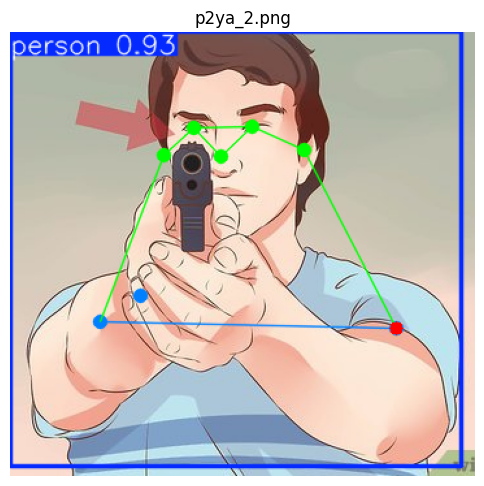

Left Shoulder: [      297.2      228.61]
Right Shoulder: [     69.954         223]
Left Elbow: [          0           0]
Right Elbow: [          0           0]
Left Wrist: [          0           0]
Right Wrist: [     100.87      203.27]
Left Eye: [     186.78      73.023]
Right Eye: [     141.73      74.712]
Left Ear: [     226.18       91.02]
Right Ear: [     118.86      95.211]
x, y:  297.1959   228.60887
l_arm_exists:  False  l_angle:  None
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
PISTOL
THREAT LEVEL 2
Image: p2ya_11.png, Size: (411, 438)

image 1/1 /content/test_imgs/p2ya_11.png: 640x608 1 person, 334.9ms
Speed: 6.5ms preprocess, 334.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 608)


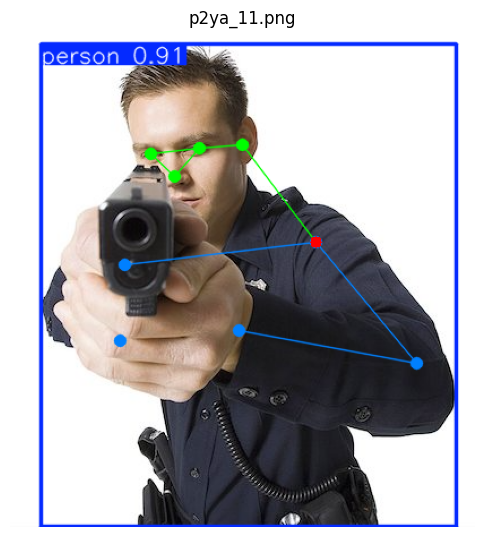

Left Shoulder: [     270.11      186.03]
Right Shoulder: [     101.09      206.46]
Left Elbow: [      359.3      293.09]
Right Elbow: [          0           0]
Left Wrist: [     202.58      264.79]
Right Wrist: [     97.134      273.64]
Left Eye: [     167.19      103.34]
Right Eye: [     124.72      108.88]
Left Ear: [      205.4      100.55]
Right Ear: [          0           0]
x, y:  270.1074   186.03075
l_arm_exists:  True  l_angle:  39.967087
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2ya_10.png, Size: (437, 373)

image 1/1 /content/test_imgs/p2ya_10.png: 576x640 1 person, 314.5ms
Speed: 5.6ms preprocess, 314.5ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)


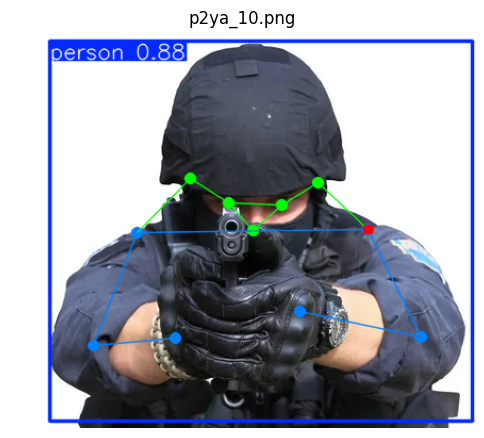

Left Shoulder: [      336.7       186.7]
Right Shoulder: [     119.55       189.4]
Left Elbow: [     386.69      287.44]
Right Elbow: [     78.189      295.94]
Left Wrist: [     272.88      263.62]
Right Wrist: [     155.16      288.71]
Left Eye: [     255.46      163.36]
Right Eye: [     205.03      161.55]
Left Ear: [     289.57      142.32]
Right Ear: [     169.05      138.39]
x, y:  336.70154   186.70253
l_arm_exists:  True  l_angle:  51.7846
r_arm_exists:  True  r_angle:  63.418694
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2ya_1.png, Size: (626, 440)

image 1/1 /content/test_imgs/p2ya_1.png: 480x640 1 person, 246.5ms
Speed: 4.3ms preprocess, 246.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


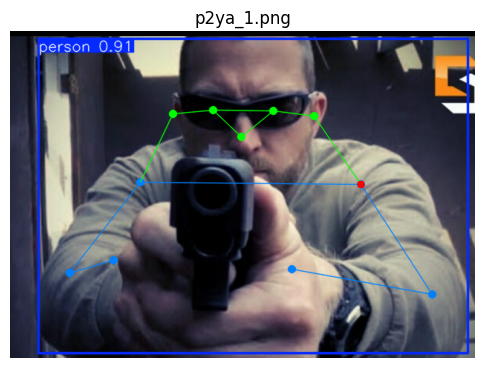

Left Shoulder: [     472.88      206.21]
Right Shoulder: [     175.55       203.9]
Left Elbow: [     568.64       354.2]
Right Elbow: [      80.22      325.84]
Left Wrist: [     379.03      320.51]
Right Wrist: [        140      308.95]
Left Eye: [     354.73      107.12]
Right Eye: [     273.53       106.2]
Left Ear: [     409.57      114.41]
Right Ear: [     219.15      111.96]
x, y:  472.87796   206.20575
l_arm_exists:  True  l_angle:  47.020084
r_arm_exists:  True  r_angle:  36.209927
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p2na_9.png, Size: (396, 372)

image 1/1 /content/test_imgs/p2na_9.png: 608x640 1 person, 360.6ms
Speed: 6.3ms preprocess, 360.6ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)


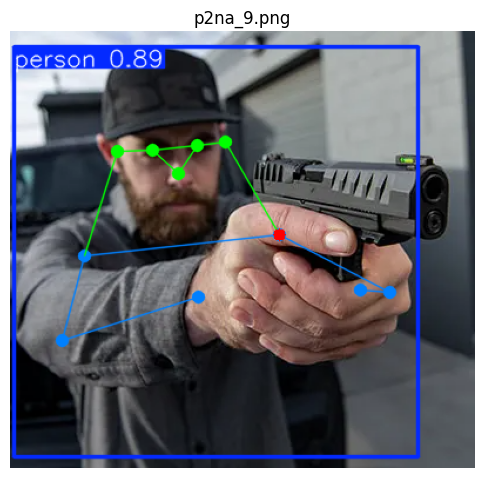

Left Shoulder: [     229.81      173.33]
Right Shoulder: [     63.857       191.6]
Left Elbow: [     323.35      222.22]
Right Elbow: [     44.031      263.52]
Left Wrist: [     298.53      220.95]
Right Wrist: [     160.83      226.94]
Left Eye: [     159.45       97.85]
Right Eye: [     121.89      101.93]
Left Ear: [     183.51       94.45]
Right Ear: [     91.073      102.65]
x, y:  229.81372   173.32965
l_arm_exists:  True  l_angle:  24.68365
r_arm_exists:  True  r_angle:  57.200195
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_8.png, Size: (624, 588)

image 1/1 /content/test_imgs/p2na_8.png: 608x640 1 person, 336.2ms
Speed: 5.3ms preprocess, 336.2ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)


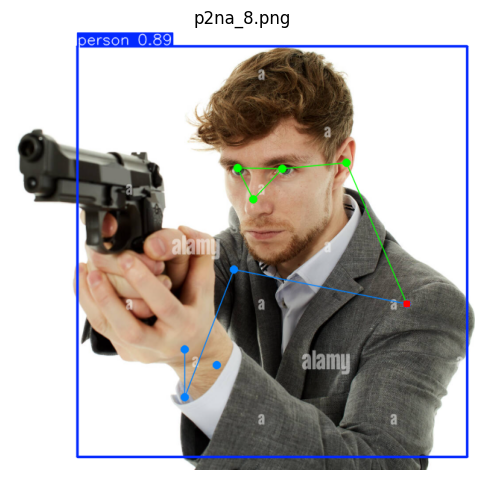

Left Shoulder: [     532.35      365.72]
Right Shoulder: [     300.14      319.08]
Left Elbow: [          0           0]
Right Elbow: [     234.93      490.59]
Left Wrist: [        277      447.45]
Right Wrist: [     234.98      426.82]
Left Eye: [     365.75      184.53]
Right Eye: [     305.56      183.24]
Left Ear: [     451.36      176.84]
Right Ear: [          0           0]
x, y:  532.34503   365.71945
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  20.774742
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 2
Image: p2na_7.png, Size: (627, 682)

image 1/1 /content/test_imgs/p2na_7.png: 640x608 1 person, 330.0ms
Speed: 6.0ms preprocess, 330.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 608)


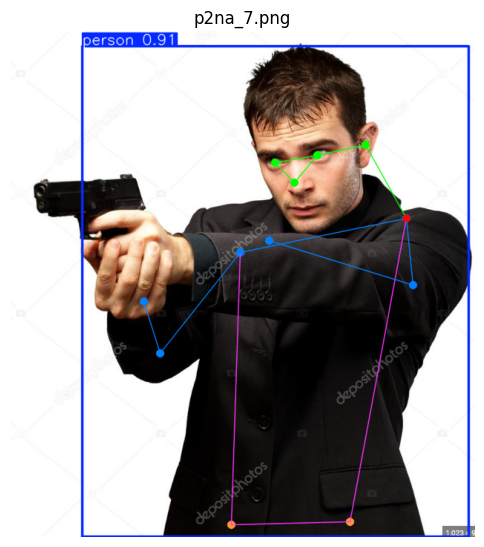

Left Shoulder: [     534.68      252.62]
Right Shoulder: [     310.82      298.56]
Left Elbow: [     543.25      342.75]
Right Elbow: [     202.58      434.16]
Left Wrist: [      349.9      282.08]
Right Wrist: [     180.78      364.58]
Left Eye: [     414.82      167.33]
Right Eye: [     357.86      177.38]
Left Ear: [     479.99      153.67]
Right Ear: [          0           0]
x, y:  534.6785   252.62029
l_arm_exists:  True  l_angle:  67.14863
r_arm_exists:  True  r_angle:  55.99584
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_6.png, Size: (444, 514)

image 1/1 /content/test_imgs/p2na_6.png: 640x576 2 persons, 298.5ms
Speed: 4.9ms preprocess, 298.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 576)


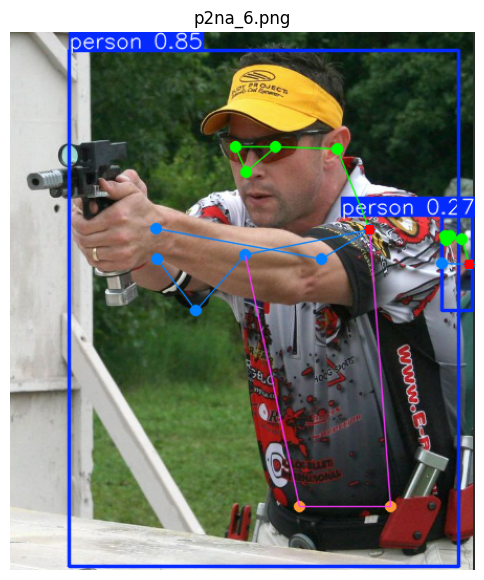

Left Shoulder: [     343.47       189.7]
Right Shoulder: [     224.56      213.57]
Left Elbow: [     297.53      217.55]
Right Elbow: [     177.61      266.04]
Left Wrist: [     139.66      188.15]
Right Wrist: [     140.46      217.67]
Left Eye: [     253.39      110.25]
Right Eye: [     215.33      110.93]
Left Ear: [     312.48      112.73]
Right Ear: [          0           0]
x, y:  343.4661   189.69633
l_arm_exists:  True  l_angle:  138.21587
r_arm_exists:  True  r_angle:  79.34775
pre one_hand:  False
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 2
Left Shoulder: [     438.65      222.11]
Right Shoulder: [     412.12      221.08]
Left Elbow: [          0           0]
Right Elbow: [          0           0]
Left Wrist: [          0           0]
Right Wrist: [          0           0]
Left Eye: [     420.94      195.57]
Right Eye: [     415.22      195.42]
Left Ear: [     431.16      198.41]
Right Ear: [          0           0]
x, y:  438.65347   222.10956
l_arm_exists

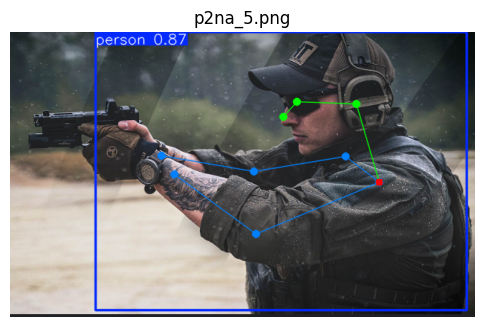

Left Shoulder: [     515.52      210.56]
Right Shoulder: [     468.32       174.5]
Left Elbow: [     343.69      282.27]
Right Elbow: [     340.36      195.38]
Left Wrist: [     229.16      199.91]
Right Wrist: [     211.23      173.94]
Left Eye: [     400.27      98.396]
Right Eye: [          0           0]
Left Ear: [     483.29      101.45]
Right Ear: [          0           0]
x, y:  515.51605   210.55885
l_arm_exists:  True  l_angle:  121.628586
r_arm_exists:  True  r_angle:  161.30591
pre one_hand:  False
PISTOL
THREAT LEVEL 2
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_4.png, Size: (333, 641)

image 1/1 /content/test_imgs/p2na_4.png: 640x352 1 person, 209.1ms
Speed: 4.4ms preprocess, 209.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 352)


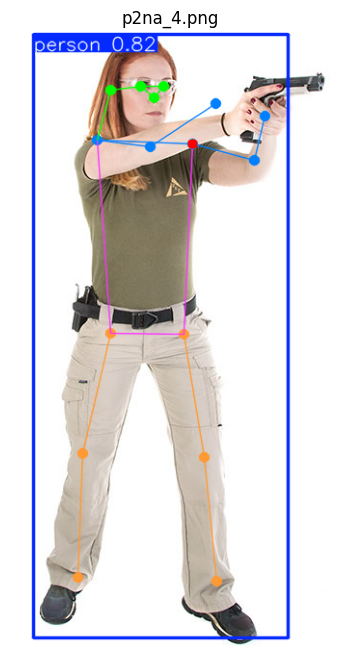

Left Shoulder: [     189.76      116.14]
Right Shoulder: [     90.376      112.45]
Left Elbow: [     253.02      133.24]
Right Elbow: [      145.6      119.72]
Left Wrist: [      264.1      87.798]
Right Wrist: [     213.27        74.9]
Left Eye: [     159.99      56.602]
Right Eye: [     135.81      56.168]
Left Ear: [          0           0]
Right Ear: [     104.09      60.918]
x, y:  189.75888   116.135544
l_arm_exists:  True  l_angle:  88.56798
r_arm_exists:  True  r_angle:  138.98015
pre one_hand:  False
PISTOL
post one_hand:  True
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_3.png, Size: (796, 674)

image 1/1 /content/test_imgs/p2na_3.png: 544x640 1 person, 350.7ms
Speed: 9.2ms preprocess, 350.7ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)


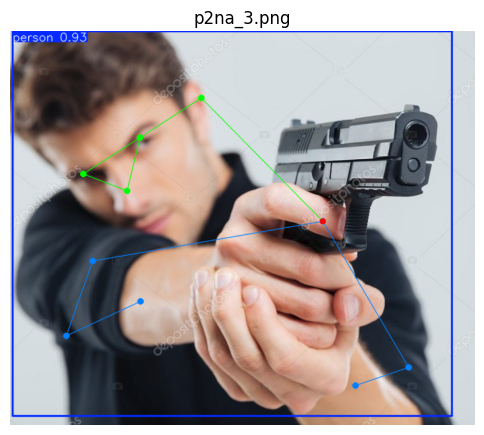

Left Shoulder: [      535.8      325.56]
Right Shoulder: [     141.76      393.61]
Left Elbow: [     682.25      575.94]
Right Elbow: [     96.388       521.9]
Left Wrist: [     591.08      606.09]
Right Wrist: [     223.96      462.18]
Left Eye: [     222.05       182.9]
Right Eye: [     125.82       244.3]
Left Ear: [     327.52      114.76]
Right Ear: [          0           0]
x, y:  535.79956   325.55563
l_arm_exists:  True  l_angle:  77.97722
r_arm_exists:  True  r_angle:  45.437107
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_2.png, Size: (357, 497)

image 1/1 /content/test_imgs/p2na_2.png: 640x480 1 person, 324.2ms
Speed: 7.0ms preprocess, 324.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 480)


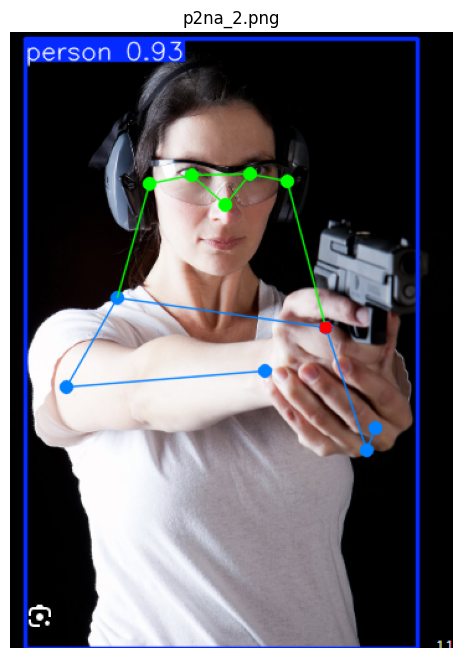

Left Shoulder: [     254.01      238.04]
Right Shoulder: [      86.32      214.28]
Left Elbow: [     287.41      337.48]
Right Elbow: [     45.594      286.13]
Left Wrist: [      294.8      319.75]
Right Wrist: [     205.18      273.15]
Left Eye: [     193.09      114.43]
Right Eye: [     146.29      115.77]
Left Ear: [     223.52       120.4]
Right Ear: [     112.87      122.32]
x, y:  254.00809   238.04384
l_arm_exists:  True  l_angle:  41.194527
r_arm_exists:  True  r_angle:  55.80433
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_11.png, Size: (505, 506)

image 1/1 /content/test_imgs/p2na_11.png: 640x640 1 person, 418.8ms
Speed: 8.3ms preprocess, 418.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


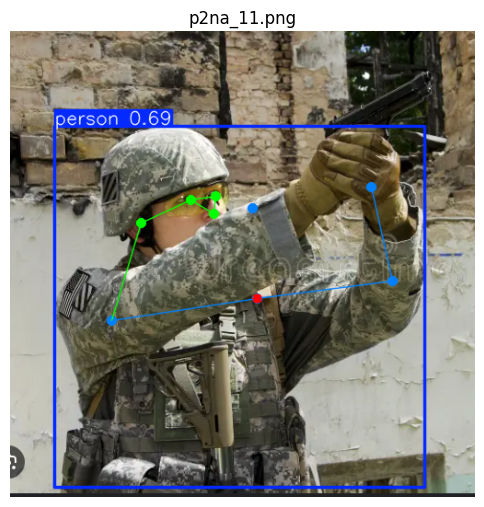

Left Shoulder: [     268.92      290.77]
Right Shoulder: [     110.98      314.91]
Left Elbow: [     415.74      271.29]
Right Elbow: [          0           0]
Left Wrist: [     392.58      169.07]
Right Wrist: [     263.97      192.93]
Left Eye: [     223.89      179.53]
Right Eye: [     196.39       183.9]
Left Ear: [          0           0]
Right Ear: [     142.38      208.09]
x, y:  268.9179   290.7657
l_arm_exists:  True  l_angle:  84.789406
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_10.png, Size: (334, 497)

image 1/1 /content/test_imgs/p2na_10.png: 640x448 1 person, 279.4ms
Speed: 4.5ms preprocess, 279.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 448)


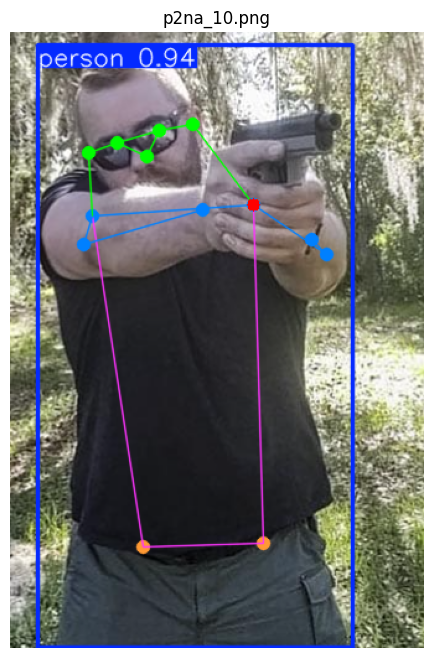

Left Shoulder: [     196.68      139.74]
Right Shoulder: [     66.499      148.21]
Left Elbow: [     255.92      179.48]
Right Elbow: [     59.836      171.64]
Left Wrist: [     243.41      167.97]
Right Wrist: [     155.18       143.7]
Left Eye: [     120.88      79.613]
Right Eye: [      86.44      89.633]
Left Ear: [     147.06      74.323]
Right Ear: [     63.945      97.234]
x, y:  196.67778   139.7372
l_arm_exists:  True  l_angle:  8.744016
r_arm_exists:  True  r_angle:  57.78703
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p2na_1.png, Size: (579, 451)

image 1/1 /content/test_imgs/p2na_1.png: 512x640 1 person, 277.5ms
Speed: 5.3ms preprocess, 277.5ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


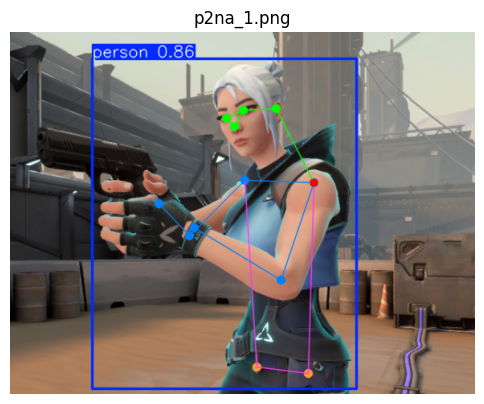

Left Shoulder: [     378.32      188.51]
Right Shoulder: [     292.23       185.3]
Left Elbow: [     337.93      309.37]
Right Elbow: [     223.14      254.29]
Left Wrist: [     229.53      244.66]
Right Wrist: [     185.05      214.28]
Left Eye: [      290.9      98.528]
Right Eye: [     269.14      108.34]
Left Ear: [     331.99      96.711]
Right Ear: [          0           0]
x, y:  378.3201   188.51497
l_arm_exists:  True  l_angle:  77.64085
r_arm_exists:  True  r_angle:  88.63103
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p1ya_9.png, Size: (199, 239)

image 1/1 /content/test_imgs/p1ya_9.png: 640x544 1 person, 306.0ms
Speed: 4.9ms preprocess, 306.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 544)


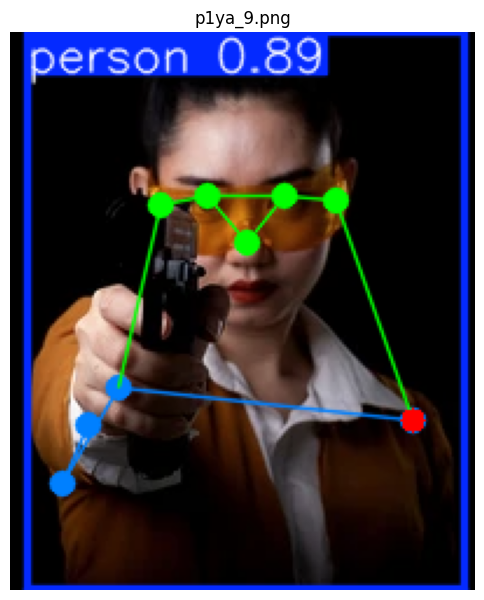

Left Shoulder: [     172.25      166.08]
Right Shoulder: [     46.223      152.32]
Left Elbow: [          0           0]
Right Elbow: [     22.259      193.96]
Left Wrist: [          0           0]
Right Wrist: [     33.225      168.72]
Left Eye: [     117.73      70.435]
Right Eye: [     84.082      70.399]
Left Ear: [     139.81      72.953]
Right Ear: [     64.041      74.527]
x, y:  172.25194   166.07913
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  6.4383054
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_8.png, Size: (307, 574)

image 1/1 /content/test_imgs/p1ya_8.png: 640x352 1 person, 206.0ms
Speed: 4.5ms preprocess, 206.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 352)


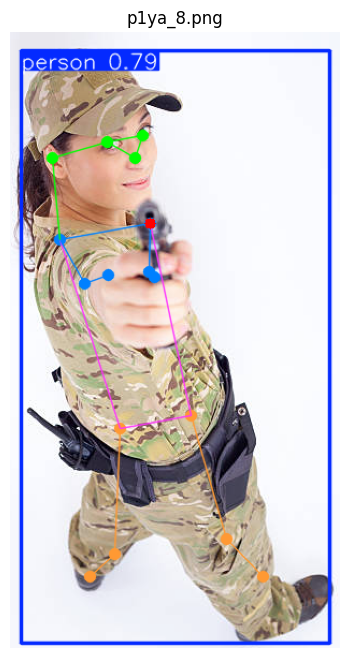

Left Shoulder: [     130.12       178.3]
Right Shoulder: [     46.402      193.75]
Left Elbow: [     129.32       223.3]
Right Elbow: [     69.881      234.44]
Left Wrist: [     134.17      228.45]
Right Wrist: [     91.111      226.02]
Left Eye: [     123.59      96.013]
Right Eye: [     90.412      102.44]
Left Ear: [          0           0]
Right Ear: [     39.773      117.94]
x, y:  130.11607   178.30391
l_arm_exists:  True  l_angle:  135.65533
r_arm_exists:  True  r_angle:  98.34046
pre one_hand:  False
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_7.png, Size: (297, 472)

image 1/1 /content/test_imgs/p1ya_7.png: 640x416 1 person, 250.1ms
Speed: 5.2ms preprocess, 250.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 416)


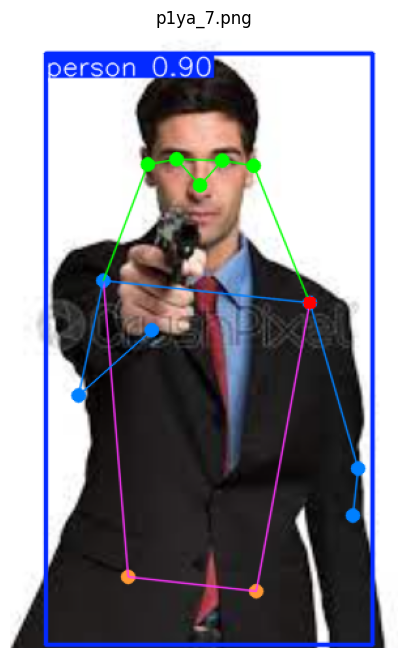

Left Shoulder: [     229.38      207.82]
Right Shoulder: [     71.577      190.05]
Left Elbow: [     266.64      334.21]
Right Elbow: [     52.888      278.63]
Left Wrist: [     262.58      370.98]
Right Wrist: [     108.08      228.47]
Left Eye: [     162.82       98.76]
Right Eye: [     127.51      97.873]
Left Ear: [     186.62      102.87]
Right Ear: [     105.06      101.26]
x, y:  229.38025   207.81975
l_arm_exists:  True  l_angle:  157.27422
r_arm_exists:  True  r_angle:  35.821136
pre one_hand:  False
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_6.png, Size: (452, 506)

image 1/1 /content/test_imgs/p1ya_6.png: 640x576 1 person, 285.1ms
Speed: 4.8ms preprocess, 285.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 576)


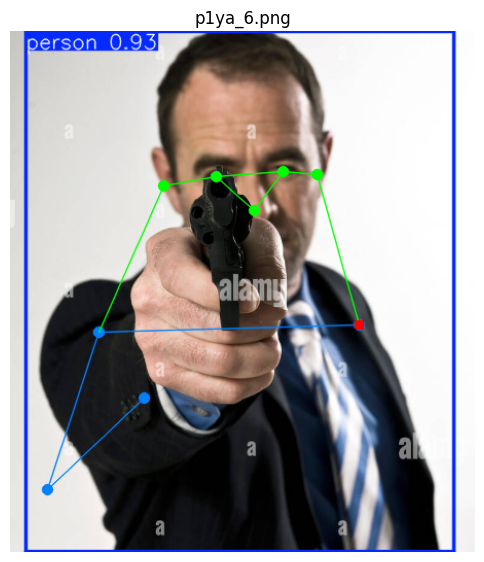

Left Shoulder: [     339.56      285.59]
Right Shoulder: [     86.275      292.43]
Left Elbow: [          0           0]
Right Elbow: [     36.734      445.14]
Left Wrist: [          0           0]
Right Wrist: [     130.38      356.09]
Left Eye: [     265.18      136.37]
Right Eye: [      200.6      141.42]
Left Ear: [     298.97      139.77]
Right Ear: [     149.91      150.56]
x, y:  339.55524   285.59308
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  28.463701
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_5.png, Size: (196, 574)

image 1/1 /content/test_imgs/p1ya_5.png: 640x224 1 person, 159.0ms
Speed: 2.2ms preprocess, 159.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 224)


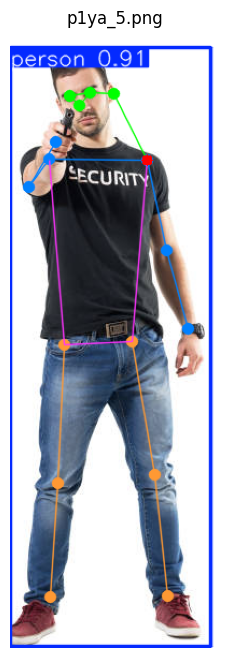

Left Shoulder: [     127.22      119.28]
Right Shoulder: [     36.387      118.26]
Left Elbow: [     145.93       203.7]
Right Elbow: [     17.797      144.37]
Left Wrist: [     165.71      276.02]
Right Wrist: [     42.359      102.44]
Left Eye: [     74.238       56.08]
Right Eye: [     55.364      59.063]
Left Ear: [     96.781      57.164]
Right Ear: [          0           0]
x, y:  127.220695   119.27732
l_arm_exists:  True  l_angle:  177.19955
r_arm_exists:  True  r_angle:  5.0974674
pre one_hand:  False
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_4.png, Size: (275, 479)

image 1/1 /content/test_imgs/p1ya_4.png: 640x384 1 person, 218.8ms
Speed: 6.2ms preprocess, 218.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)


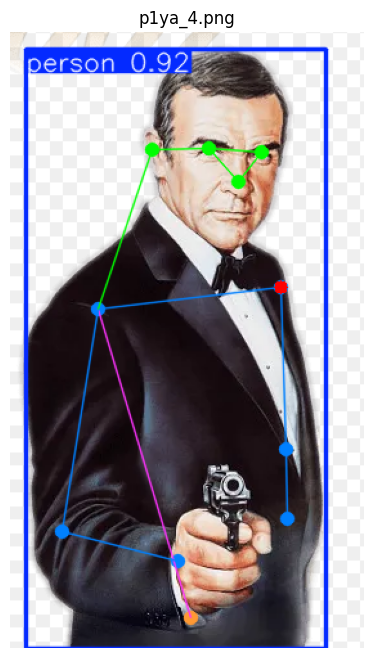

Left Shoulder: [     210.86      198.72]
Right Shoulder: [     68.719       215.7]
Left Elbow: [     214.78      324.42]
Right Elbow: [     40.286      388.09]
Left Wrist: [     215.78      378.57]
Right Wrist: [     130.93      411.79]
Left Eye: [     195.84      93.329]
Right Eye: [     154.74      90.287]
Left Ear: [          0           0]
Right Ear: [     110.39      91.358]
x, y:  210.86372   198.72217
l_arm_exists:  True  l_angle:  179.27719
r_arm_exists:  True  r_angle:  95.28711
pre one_hand:  False
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_3.png, Size: (529, 538)

image 1/1 /content/test_imgs/p1ya_3.png: 640x640 1 person, 389.3ms
Speed: 6.8ms preprocess, 389.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


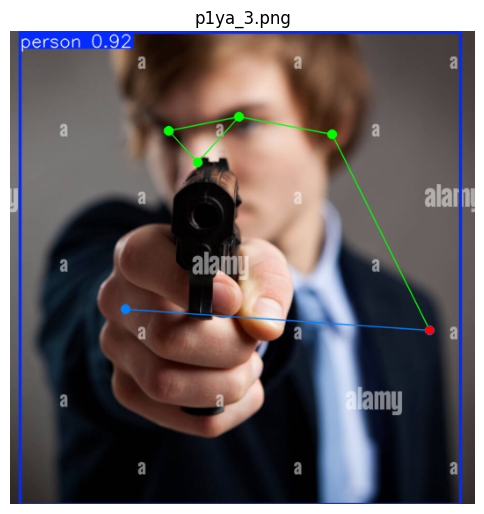

Left Shoulder: [        478       340.9]
Right Shoulder: [     131.49      316.85]
Left Elbow: [          0           0]
Right Elbow: [          0           0]
Left Wrist: [          0           0]
Right Wrist: [          0           0]
Left Eye: [     260.19      97.974]
Right Eye: [     180.93      113.65]
Left Ear: [     366.51      117.57]
Right Ear: [          0           0]
x, y:  477.9998   340.89517
l_arm_exists:  False  l_angle:  None
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
PISTOL
THREAT LEVEL 2
Image: p1ya_2.png, Size: (536, 403)

image 1/1 /content/test_imgs/p1ya_2.png: 512x640 1 person, 282.5ms
Speed: 8.4ms preprocess, 282.5ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


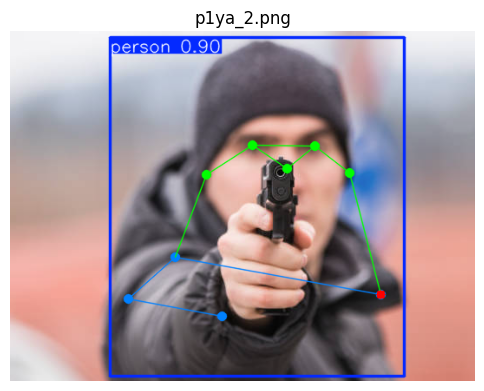

Left Shoulder: [     427.57      303.61]
Right Shoulder: [     190.62      260.36]
Left Elbow: [          0           0]
Right Elbow: [     136.13      308.55]
Left Wrist: [          0           0]
Right Wrist: [     244.77      328.11]
Left Eye: [     351.12       132.3]
Right Eye: [     279.41      131.57]
Left Ear: [     391.09      163.88]
Right Ear: [     226.35      165.18]
x, y:  427.56635   303.61398
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  51.697777
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_11.png, Size: (498, 917)

image 1/1 /content/test_imgs/p1ya_11.png: 640x352 1 person, 224.0ms
Speed: 4.1ms preprocess, 224.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 352)


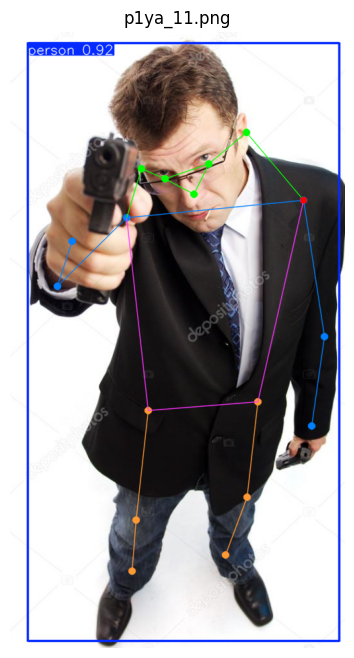

Left Shoulder: [     436.78      250.48]
Right Shoulder: [     173.15       276.7]
Left Elbow: [     467.58      453.85]
Right Elbow: [     70.469      378.45]
Left Wrist: [     448.83      586.83]
Right Wrist: [     92.428       311.2]
Left Eye: [     295.57      196.99]
Right Eye: [     230.01      218.39]
Left Ear: [     351.54      149.57]
Right Ear: [     195.79      203.47]
x, y:  436.78442   250.47552
l_arm_exists:  True  l_angle:  163.36372
r_arm_exists:  True  r_angle:  27.177656
pre one_hand:  False
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 2
Image: p1ya_10.png, Size: (409, 728)

image 1/1 /content/test_imgs/p1ya_10.png: 640x384 1 person, 219.3ms
Speed: 7.7ms preprocess, 219.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)


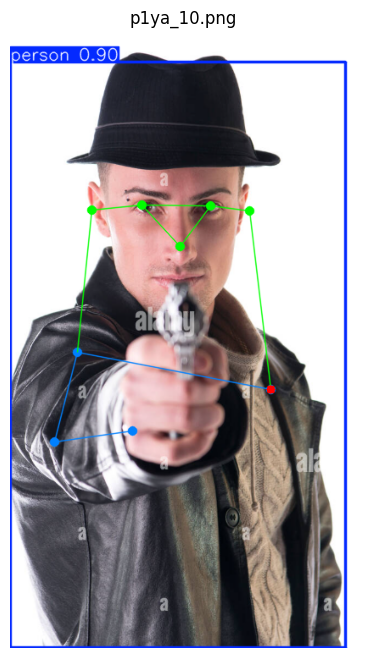

Left Shoulder: [     307.86      422.92]
Right Shoulder: [     79.099      378.89]
Left Elbow: [          0           0]
Right Elbow: [      52.37      484.71]
Left Wrist: [          0           0]
Right Wrist: [      144.3      471.12]
Left Eye: [     236.93      205.33]
Right Eye: [     155.76      204.82]
Left Ear: [     282.26      211.53]
Right Ear: [     96.618      210.77]
x, y:  307.8628   422.92422
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  67.41881
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1ya_1.png, Size: (1044, 832)

image 1/1 /content/test_imgs/p1ya_1.png: 512x640 1 person, 290.8ms
Speed: 5.4ms preprocess, 290.8ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


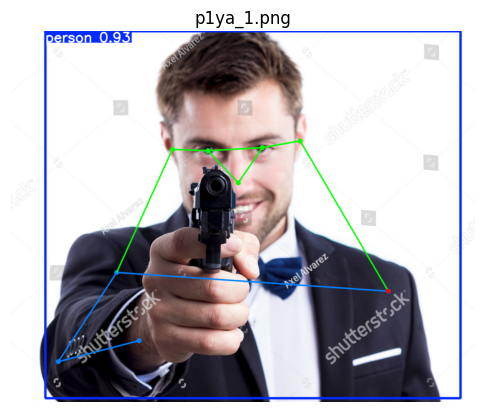

Left Shoulder: [     849.12      583.57]
Right Shoulder: [     239.68      541.86]
Left Elbow: [          0           0]
Right Elbow: [     108.57      741.97]
Left Wrist: [          0           0]
Right Wrist: [     289.65      694.46]
Left Eye: [     566.26      261.61]
Right Eye: [     444.73      268.41]
Left Ear: [     651.11      246.02]
Right Ear: [     364.39      265.17]
x, y:  849.11566   583.56744
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  42.065575
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 3
Image: p1na_9.png, Size: (338, 408)

image 1/1 /content/test_imgs/p1na_9.png: 640x544 1 person, 298.3ms
Speed: 8.2ms preprocess, 298.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 544)


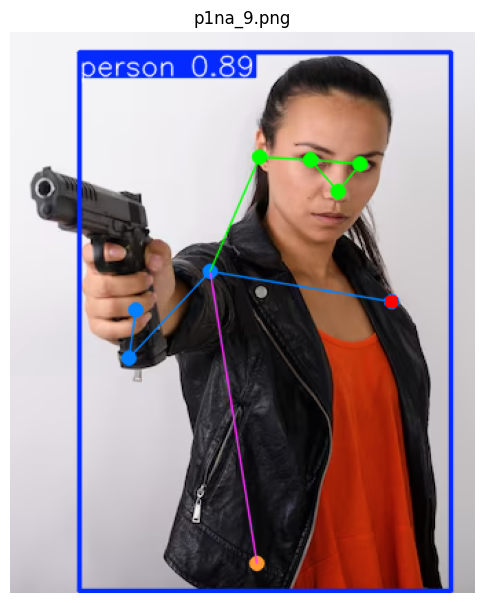

Left Shoulder: [     277.33      196.19]
Right Shoulder: [     145.96      174.97]
Left Elbow: [          0           0]
Right Elbow: [     86.369      237.88]
Left Wrist: [          0           0]
Right Wrist: [     91.621      202.83]
Left Eye: [     254.98      96.055]
Right Eye: [     218.39      93.679]
Left Ear: [          0           0]
Right Ear: [     181.11      91.243]
x, y:  277.3298   196.19003
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  34.92512
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 2
Image: p1na_8.png, Size: (276, 387)

image 1/1 /content/test_imgs/p1na_8.png: 640x480 1 person, 273.1ms
Speed: 4.4ms preprocess, 273.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


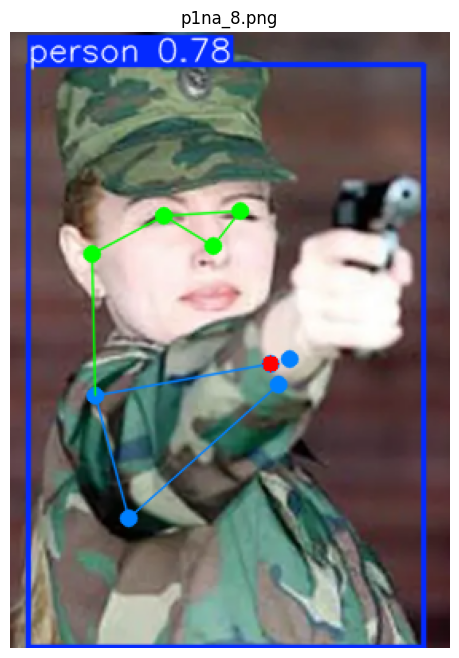

Left Shoulder: [     163.88      208.66]
Right Shoulder: [     53.676      228.37]
Left Elbow: [          0           0]
Right Elbow: [     74.224      305.44]
Left Wrist: [     175.26      205.89]
Right Wrist: [      168.6      221.99]
Left Eye: [      144.2      112.26]
Right Eye: [     96.493      115.63]
Left Ear: [          0           0]
Right Ear: [     51.543      139.38]
x, y:  163.8813   208.65633
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  63.443832
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 2
Image: p1na_7.png, Size: (743, 426)

image 1/1 /content/test_imgs/p1na_7.png: 384x640 1 person, 208.3ms
Speed: 4.0ms preprocess, 208.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


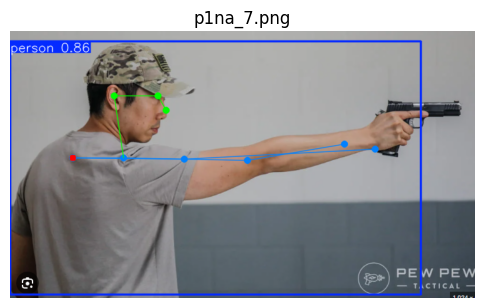

Left Shoulder: [     100.19      202.93]
Right Shoulder: [     181.34      202.48]
Left Elbow: [     278.81      204.51]
Right Elbow: [     379.77      206.81]
Left Wrist: [     583.08      188.08]
Right Wrist: [     534.92      180.18]
Left Eye: [          0           0]
Right Eye: [     236.21      103.91]
Left Ear: [          0           0]
Right Ear: [     166.91      103.45]
x, y:  100.189865   202.92796
l_arm_exists:  True  l_angle:  176.39917
r_arm_exists:  True  r_angle:  169.01137
pre one_hand:  False
PISTOL
THREAT LEVEL 2
THREAT LEVEL 2
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p1na_6.png, Size: (478, 962)

image 1/1 /content/test_imgs/p1na_6.png: 640x320 1 person, 179.7ms
Speed: 3.4ms preprocess, 179.7ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 320)


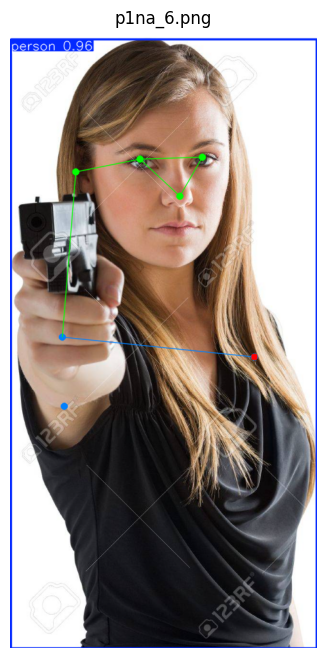

Left Shoulder: [     380.83      507.19]
Right Shoulder: [      81.91      476.43]
Left Elbow: [          0           0]
Right Elbow: [          0           0]
Left Wrist: [          0           0]
Right Wrist: [     84.338      584.58]
Left Eye: [     299.52      195.16]
Right Eye: [     202.49      198.29]
Left Ear: [          0           0]
Right Ear: [     102.79      218.48]
x, y:  380.8262   507.18622
l_arm_exists:  False  l_angle:  None
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
PISTOL
THREAT LEVEL 2
Image: p1na_5.png, Size: (460, 430)

image 1/1 /content/test_imgs/p1na_5.png: 608x640 1 person, 335.4ms
Speed: 5.7ms preprocess, 335.4ms inference, 1.7ms postprocess per image at shape (1, 3, 608, 640)


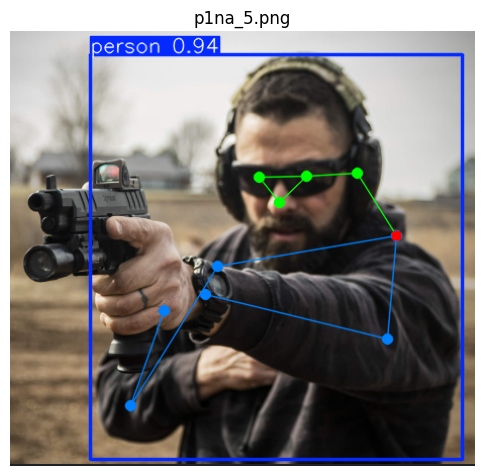

Left Shoulder: [     382.95      202.04]
Right Shoulder: [     205.98      232.98]
Left Elbow: [     373.22      304.66]
Right Elbow: [      119.1      370.25]
Left Wrist: [     193.84      260.73]
Right Wrist: [     152.33      276.39]
Left Eye: [     293.74      143.89]
Right Eye: [     246.22      144.68]
Left Ear: [     343.39      140.01]
Right Ear: [          0           0]
x, y:  382.9546   202.03876
l_arm_exists:  True  l_angle:  81.66109
r_arm_exists:  True  r_angle:  12.831966
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p1na_4.png, Size: (391, 380)

image 1/1 /content/test_imgs/p1na_4.png: 640x640 1 person, 351.7ms
Speed: 7.1ms preprocess, 351.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


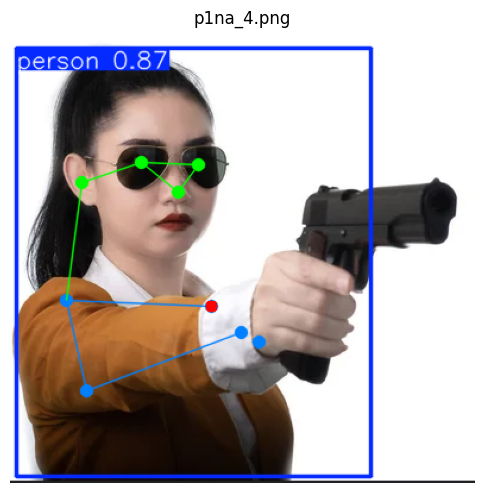

Left Shoulder: [     169.68      231.61]
Right Shoulder: [     47.865       226.8]
Left Elbow: [          0           0]
Right Elbow: [     64.945      302.89]
Left Wrist: [     209.88      261.27]
Right Wrist: [     194.27      253.95]
Left Eye: [     158.27      112.03]
Right Eye: [     110.61      110.51]
Left Ear: [          0           0]
Right Ear: [     60.096      127.35]
x, y:  169.67693   231.61432
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  81.92157
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 2
Image: p1na_3.png, Size: (398, 409)

image 1/1 /content/test_imgs/p1na_3.png: 640x640 1 person, 363.0ms
Speed: 6.2ms preprocess, 363.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


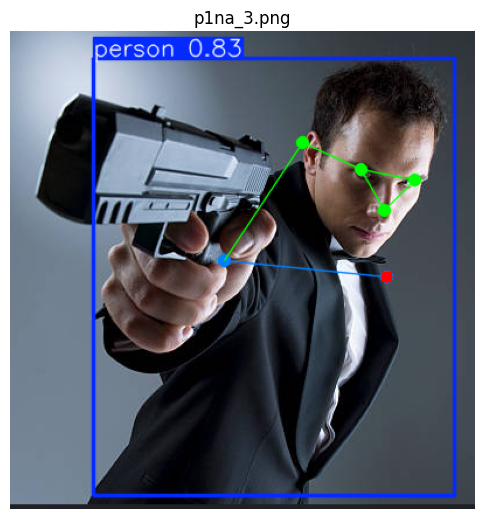

Left Shoulder: [     322.88      210.79]
Right Shoulder: [     183.67       196.1]
Left Elbow: [          0           0]
Right Elbow: [          0           0]
Left Wrist: [          0           0]
Right Wrist: [          0           0]
Left Eye: [      346.3      127.67]
Right Eye: [      300.8      118.25]
Left Ear: [          0           0]
Right Ear: [     250.92      95.708]
x, y:  322.87973   210.79393
l_arm_exists:  False  l_angle:  None
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
PISTOL
THREAT LEVEL 2
Image: p1na_2.png, Size: (697, 426)

image 1/1 /content/test_imgs/p1na_2.png: 416x640 1 person, 269.9ms
Speed: 5.4ms preprocess, 269.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


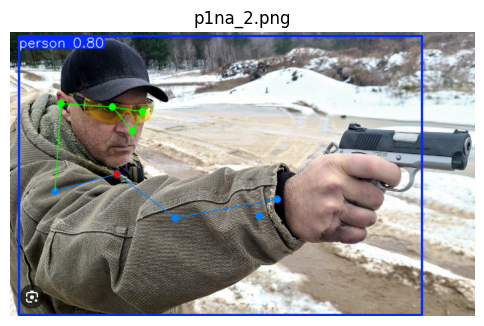

Left Shoulder: [     160.08      213.44]
Right Shoulder: [     67.343      239.24]
Left Elbow: [     247.25      279.03]
Right Elbow: [          0           0]
Left Wrist: [     400.56      251.87]
Right Wrist: [     373.48      276.74]
Left Eye: [     198.45      120.97]
Right Eye: [     153.15      113.41]
Left Ear: [          0           0]
Right Ear: [     76.879       108.1]
x, y:  160.07867   213.44458
l_arm_exists:  True  l_angle:  132.99307
r_arm_exists:  False  r_angle:  None
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p1na_11.png, Size: (510, 491)

image 1/1 /content/test_imgs/p1na_11.png: 640x640 1 person, 346.5ms
Speed: 8.4ms preprocess, 346.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


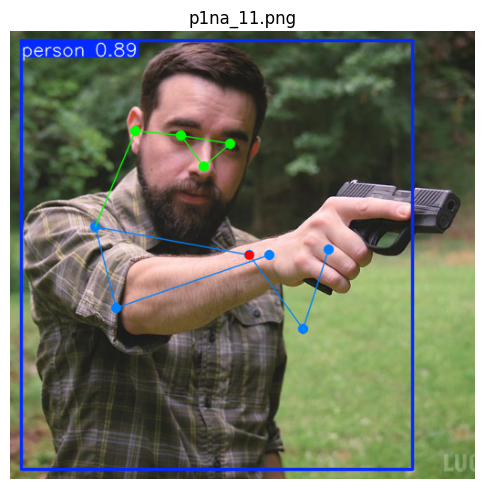

Left Shoulder: [     262.26      245.26]
Right Shoulder: [     93.052      214.61]
Left Elbow: [     321.48       326.6]
Right Elbow: [     116.61      303.35]
Left Wrist: [      349.8      239.75]
Right Wrist: [     284.93      245.02]
Left Eye: [     241.98      123.71]
Right Eye: [     187.06      114.04]
Left Ear: [          0           0]
Right Ear: [     137.36      109.57]
x, y:  262.26123   245.25636
l_arm_exists:  True  l_angle:  54.11446
r_arm_exists:  True  r_angle:  85.75338
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 2
Image: p1na_10.png, Size: (501, 491)

image 1/1 /content/test_imgs/p1na_10.png: 640x640 1 person, 385.1ms
Speed: 6.9ms preprocess, 385.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


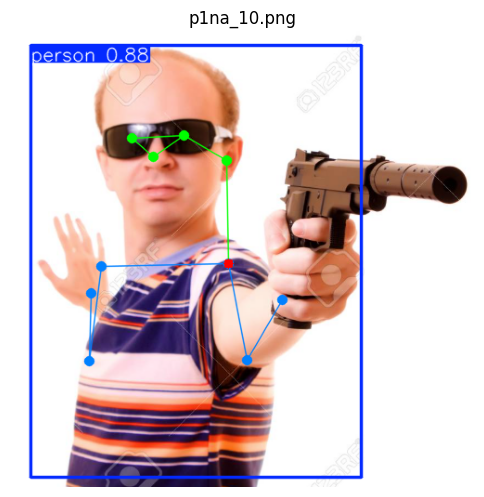

Left Shoulder: [     235.03      250.17]
Right Shoulder: [      98.61       253.7]
Left Elbow: [     255.84      354.45]
Right Elbow: [     85.831      355.35]
Left Wrist: [     293.69      289.93]
Right Wrist: [     87.973      282.22]
Left Eye: [      187.3      112.83]
Right Eye: [     131.27      115.62]
Left Ear: [     233.43      139.49]
Right Ear: [          0           0]
x, y:  235.03421   250.16782
l_arm_exists:  True  l_angle:  41.682087
r_arm_exists:  True  r_angle:  5.48723
pre one_hand:  False
PISTOL
post one_hand:  False
pistol_hand:  LEFT
THREAT LEVEL 3
Image: p1na_1.png, Size: (696, 474)

image 1/1 /content/test_imgs/p1na_1.png: 448x640 1 person, 247.2ms
Speed: 4.6ms preprocess, 247.2ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


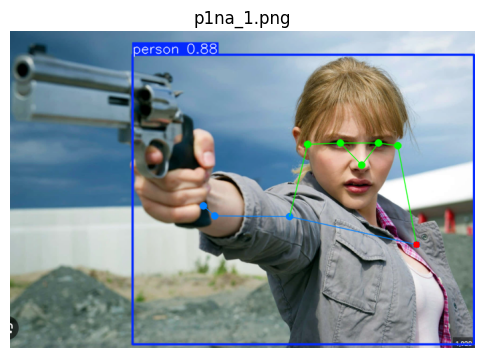

Left Shoulder: [     608.28      319.63]
Right Shoulder: [     418.08      277.53]
Left Elbow: [          0           0]
Right Elbow: [     306.76      276.98]
Left Wrist: [          0           0]
Right Wrist: [     289.28      261.19]
Left Eye: [     551.21      167.63]
Right Eye: [     494.94       167.2]
Left Ear: [     580.51      171.98]
Right Ear: [     445.38      169.76]
x, y:  608.2758   319.6295
l_arm_exists:  False  l_angle:  None
r_arm_exists:  True  r_angle:  138.18877
pre one_hand:  True
PISTOL
post one_hand:  True
pistol_hand:  RIGHT
THREAT LEVEL 2


"\nAiming Pistol\n  Using one or both hands (Weaver Stance?)\n    Aiming at camera if x and y coordinate for aiming wrist and hand lineup with eye level\n      Line created by Wrist, elbow, and shoulder of aiming arm should be minimal\n      For both hands, Wrists converge to middle of head, both arms are square with shoulders (within shoulder limits)\n      For one hand, wrist, elbow, and shoulder form a line\n    If second hand supports aiming hand, it shouldn’t affect aim\nAiming Rifle\n  Aiming at camera if x and y coordinate for both wrists lineup\n    If both wrists lines up with shoulder?  \n    Rifle is near face or eye level\n\nFind location for eyes/face/head/mouth/neck, wrists (midpoint of elbows?), and shoulders\nwrists should be near neck level? below eyes\n\n- should have color (light red to very red) to indicate threat level confidence?\n\n# Analyze the visible or closer hand\n- Possible Yes Aim: Wrists between shoulders\n# Pistol, 1 hand, no  aim: wrist is not aligned w

In [ ]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import math
import numpy as np

# Load the YOLOv8 pose model
model = YOLO("yolov8n-pose.pt")

# Run pose detection on both uploaded images
'''
image1_path = "r2na_9.png"
image2_path = "r2ya_10.png"

results1 = model(image1_path)
results2 = model(image2_path)
'''

# Function to visualize result
def show_pose_result(result, title):
    plotted_img = result[0].plot()
    plt.figure(figsize=(6, 8))
    plt.title(title)
    for person in result[0].keypoints.xy:
        keypoints = person.cpu().numpy()
        left_shoulder = keypoints[5]
        x = left_shoulder[0]
        y = left_shoulder[1]
        cv2.circle(plotted_img, (int(x), int(y)), 5, (0, 0, 255), -1) #bgr
        #cv2.circle(plotted_img, (100, 300), 5, (0, 0, 255), -1) #bgr
    plt.imshow(cv2.cvtColor(plotted_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Show both images with keypoints
#show_pose_result(results1, "Pose Estimation: Man Pointing Gun")
#show_pose_result(results2, "Pose Estimation: Man Pointing Gun (Front View)")



import os
from PIL import Image

def direction_vector(a, b):
    v = b - a
    return v# / (np.linalg.norm(v) + 1e-6)

#lw_to_nose = direction_vector(left_wrist, nose)

def arm_angle(shoulder, elbow, wrist):
    a = shoulder - elbow
    b = wrist - elbow
    cosine = np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b) + 1e-6)
    return np.degrees(np.arccos(np.clip(cosine, -1.0, 1.0)))

def within_circle(circle_center, point, circle_radius):
    distance = math.sqrt((point[0] - circle_center[0])**2 + (point[1] - circle_center[1])**2)
    return distance < circle_radius

def find_line(px, py, qx, qy):
    if px == qx:
        return None, None  # Vertical line, slope is undefined

    m = (py - qy) / (px - qx)
    b = py - m * px
    return m, b

def find_intersection(m1, b1, m2, b2):
    if m1 == m2:
        return None, None  # Lines are parallel

    x = (b2 - b1) / (m1 - m2)
    y = m1 * x + b1
    return x, y

def iterate_images(folder_path):
    """Iterates through all image files in a folder and prints their paths and sizes.

    Args:
        folder_path: The path to the folder containing the images.
    """
    num_imgs = 0
    all_imgs = []
    for filename in os.listdir(folder_path):
        num_imgs+=1
        all_imgs+=[filename]
    all_imgs.sort(reverse=True)

    for filename in all_imgs:
        if filename.lower().endswith(('.png')):#, '.jpg', '.jpeg', '.gif', '.bmp')):
            image_path = os.path.join(folder_path, filename)
            try:
                img = Image.open(image_path)
                img_name = os.path.basename(image_path)
                print(f"Image: {img_name}, Size: {img.size}")
                #display(img)
                result = model(image_path)
                show_pose_result(result, img_name)

                for person in result[0].keypoints.xy:
                    keypoints = person.cpu().numpy()
                    l_shoulder = keypoints[5]
                    r_shoulder = keypoints[6]
                    l_elbow = keypoints[7]
                    r_elbow = keypoints[8]
                    l_wrist = keypoints[9]
                    r_wrist = keypoints[10]
                    l_eye = keypoints[1]
                    r_eye = keypoints[2]
                    l_ear = keypoints[3]
                    r_ear = keypoints[4]
                    print(f"Left Shoulder: {l_shoulder}")
                    print(f"Right Shoulder: {r_shoulder}")
                    print(f"Left Elbow: {l_elbow}")
                    print(f"Right Elbow: {r_elbow}")
                    print(f"Left Wrist: {l_wrist}")
                    print(f"Right Wrist: {r_wrist}")
                    print(f"Left Eye: {l_eye}")
                    print(f"Right Eye: {r_eye}")
                    print(f"Left Ear: {l_ear}")
                    print(f"Right Ear: {r_ear}")
                    x = l_shoulder[0]
                    y = l_shoulder[1]
                    print("x, y: ", x, " ", y)

                    one_hand = False
                    pistol_hand = "LEFT"
                    l_elbow_exists = (l_elbow[0] != 0 or l_elbow[1] != 0)
                    r_elbow_exists = (r_elbow[0] != 0 or r_elbow[1] != 0)
                    r_wrist_exists = (r_wrist[0] != 0 or r_wrist[1] != 0)
                    l_wrist_exists = (l_wrist[0] != 0 or l_wrist[1] != 0)
                    l_eye_exists = (l_eye[0] != 0 or l_eye[1] != 0)
                    r_eye_exists = (r_eye[0] != 0 or r_eye[1] != 0)
                    l_ear_exists = (l_ear[0] != 0 or l_ear[1] != 0)
                    r_ear_exists = (r_ear[0] != 0 or r_ear[1] != 0)

                    l_arm_exists = l_elbow_exists and l_wrist_exists
                    r_arm_exists = r_elbow_exists and r_wrist_exists

                    l_angle = None
                    r_angle = None
                    if l_arm_exists:
                        l_angle = arm_angle(l_shoulder, l_elbow, l_wrist)
                    else:
                        one_hand = True
                    if r_arm_exists:
                        r_angle = arm_angle(r_shoulder, r_elbow, r_wrist)
                    else:
                        one_hand = True

                    print("l_arm_exists: ", l_arm_exists, " l_angle: ", l_angle)
                    print("r_arm_exists: ", r_arm_exists, " r_angle: ", r_angle)
                    print("pre one_hand: ", one_hand)

                    if img_name[0] == "p": #if detected gun is a pistol
                        print("PISTOL")
                        # Differentiating between 1 hand and 2 hands:  if one arm is obtuse angle (>135), or if arm (wrist and elbow) doesnt exist

                        if (l_arm_exists and not r_arm_exists):
                            one_hand = True
                            pistol_hand = "LEFT"
                        elif (r_arm_exists and not l_arm_exists):
                            one_hand = True
                            pistol_hand = "RIGHT"
                        elif (not l_arm_exists) and (not r_arm_exists):
                            print("THREAT LEVEL 2")
                            continue

                        # below code will work mostly for one hand?????
                        if (l_arm_exists and l_angle > 120):
                            if (r_arm_exists and r_angle > 150):
                                one_hand = False
                                print("THREAT LEVEL 2")
                                #continue
                            elif (r_arm_exists and r_angle < 100):
                                one_hand = True
                                pistol_hand = "RIGHT"
                        if (r_arm_exists and r_angle > 120):
                            if (l_arm_exists and l_angle > 150):
                                one_hand = False
                                print("THREAT LEVEL 2")
                                #continue
                            elif (l_arm_exists and l_angle < 100):
                                one_hand = True
                                pistol_hand = "LEFT"
                        print("post one_hand: ", one_hand)
                        print("pistol_hand: ", pistol_hand)


                        # P, 1 hand, no  aim: wrist is not aligned with shoulder
                        #     wrist is certain distance away from side of eye, the wrist near eye is away from person
                        #     Code: Wrist is near opposite shoulder OR Wrist is "greater than" opposite shoulder, OR wrist is outside of same shoulder (by significant amount)
                        #                            img 8, 5, 4, 1            img 2, 7 (find better imgs)              img 1, 9, 10

                        # P, 1 hand, yes aim: wrist is aligned with shoulder (difficult, get more imgs)
                        #     Code: wrist holding gun is between shoulder and opposite eye?  or midpoint of shoulders?
                        l_mod_wrist = l_wrist[0]
                        if l_arm_exists and l_angle < 10:
                            l_mod_wrist = l_shoulder[0]
                        r_mod_wrist = r_wrist[0]
                        if r_arm_exists and r_angle < 10:
                            r_mod_wrist = r_shoulder[0]
                        if one_hand:
                            if pistol_hand == "LEFT":

                                if within_circle(r_shoulder, l_wrist, 20) or l_mod_wrist < r_shoulder[0] or l_mod_wrist > l_shoulder[0] + 20:
                                    print("THREAT LEVEL 2")
                                    continue
                                elif l_mod_wrist <= l_shoulder[0] or within_circle(l_shoulder, l_wrist, 20) or (r_eye_exists and (l_mod_wrist >= r_eye[0])): #use r_ear?
                                    print("THREAT LEVEL 3") #yes aim
                                    continue
                                else:
                                    print("One Left Hand: Couldn't Determine")
                                    continue
                            elif pistol_hand == "RIGHT":

                                if within_circle(l_shoulder, r_wrist, 20) or r_mod_wrist > l_shoulder[0] or r_mod_wrist < max(r_shoulder[0] - 20, 0):
                                    print("THREAT LEVEL 2")
                                    continue
                                elif r_mod_wrist >=r_shoulder[0] or within_circle(r_shoulder, r_wrist, 20) or (l_eye_exists and (r_mod_wrist <= l_eye[0])): #use l_ear?
                                    print("THREAT LEVEL 3") # yes aim
                                    continue
                                else:
                                    print("One Right Hand: Couldn't Determine")
                                    continue


                        # P, 2 hand, no  aim: one or both wrists (x-val) are outside of shoulders OR
                        #     midpoint of wrists is not within outer eye or ear distance AND the wrist that is outside of the eye/ear distance,
                        #     that wrist is past midpoint of shoulder (x-val)

                        # P, 2 hand, yes aim: midpoint of wrists is between eye or ear distance AND both wrists are between shoulders (x-val),
                        #     measure angle?  (should be acute for both arms)
                        else: # both hands used to hold gun
                            wrist_midpoint = r_mod_wrist + ((l_mod_wrist - r_mod_wrist)//2)
                            leftmost_facial_ftr = max(l_eye[0], l_ear[0])
                            if leftmost_facial_ftr == 0:
                                leftmost_facial_ftr = l_shoulder[0]
                            if (r_ear_exists):
                                rightmost_facial_ftr = r_ear[0]
                            elif (r_eye_exists):
                                rightmost_facial_ftr = r_eye[0]
                            else:
                                rightmost_facial_ftr = r_shoulder[0]

                            if (wrist_midpoint > leftmost_facial_ftr) or (wrist_midpoint < rightmost_facial_ftr):
                                print("THREAT LEVEL 2")
                                continue
                            else:
                                print("THREAT LEVEL 3")
                                continue


                            if l_angle > 120 and r_angle > 120: # ??120?? 110?  90?
                                print("THREAT LEVEL 2")
                            if l_wrist[0] < r_shoulder[0] or r_wrist[0] > l_shoulder[0] or \
                              (r_wrist[0] < max(r_shoulder[0] - 20, 0) and r_angle > 10) or (l_wrist[0] > l_shoulder[0] + 20 and l_angle > 10):
                                print("THREAT LEVEL 2")
                                print("pistol both hands, out of shoulder width")
                                continue
                            print("both hands, nothing decided????????")


                    elif img_name[0] == "r": #if detected gun is a rifle
                        print("RIFLE")
                        # Check if both wrists overlap, if one wrist doesn't exist, check if closer arm's wrist overlaps with opposite shoulder
                        # one or both wrists must be within shoulder
                        # R, 2 hand, no  aim: If both wrists are past the shoulder or if wrists are too far apart (0.6? of shoulders width)

                        # R, 2 hand, yes aim: If wrists are less than 0.6 shoulder apart
                        #    (both wrists converge to certain shoulder, both wrists are near the circle?)
                        #     Compare angles created by shoulder-elbow and elbow-wrist.  Use arm with greater angle.
                        #     if line created by wrist-elbow and shoulders intersect near shoulder, then good.
                        #  if angle created by other arm is very small (less than 30 degrees) (means wrist is close to shoulder)
                        wrists_width = np.linalg.norm(np.abs(l_wrist - r_wrist))
                        shoulders_width = np.linalg.norm(np.abs(l_shoulder - r_shoulder))
                        print("wrists_width: ", wrists_width)
                        print("shoulders_width: ", shoulders_width)
                        if wrists_width > 0.7 * shoulders_width:
                            print("THREAT LEVEL 2, r1")
                            continue
                        if (l_wrist[0] < r_shoulder[0] and r_wrist[0] < max(r_shoulder[0] - 10, 0)) or (r_wrist[0] > l_shoulder[0] and l_wrist[0] > l_shoulder[0] + 10):
                            print("THREAT LEVEL 2, r2") # both wrists are away from shoulder,  -20? -15?
                            # check arm angle?????
                            continue
                        if (l_wrist[0] > l_shoulder[0] + 0.4*shoulders_width) or (r_wrist[0] < max(r_shoulder[0] - 0.4*shoulders_width, 0)): #0.5? 0.6?
                            print("THREAT LEVEL 2, r3") # both wrists are away from shoulder
                            # check arm angle?????
                            continue


                        print("Testing for threat level 3")
                        l_mod_wrist = l_wrist[0]
                        if l_arm_exists and r_arm_exists:
                            if l_angle > r_angle:
                                support_arm = "LEFT"
                            elif l_angle < r_angle:
                                support_arm = "RIGHT"

                        r_mod_wrist = r_wrist[0]
                        if l_arm_exists and l_angle < 15:
                            l_mod_wrist = l_shoulder[0]
                        r_mod_wrist = r_wrist[0]
                        if r_arm_exists and r_angle < 15:
                            r_mod_wrist = r_shoulder[0]
                        shoulder_m, shoulder_b = find_line(l_shoulder[0], -l_shoulder[1], r_shoulder[0], -r_shoulder[1])
                        # print("shoulder_m", shoulder_m, " shoulder_b: ", shoulder_b)
                        if support_arm == "LEFT":
                            support_m, support_b = find_line(l_elbow[0], -l_elbow[1], l_wrist[0], -l_wrist[1])
                        elif support_arm == "RIGHT":
                            support_m, support_b = find_line(r_elbow[0], -r_elbow[1], r_wrist[0], -r_wrist[1])
                        # print("support_m: ", support_m, " support_b: ", support_b)
                        if shoulder_b is not None and support_b is not None:
                            x, y = find_intersection(shoulder_m, shoulder_b, support_m, support_b)
                            x = abs(x)
                            y = abs(y)
                            # print("intersection: ", x, " ", y)
                            if x is not None and y is not None:
                                if support_arm == "LEFT" and within_circle(r_shoulder, (x, y), 0.33 * shoulders_width) or \
                                   support_arm == "RIGHT" and within_circle(l_shoulder, (x, y), 0.33 * shoulders_width):  #0.2?, 0.1?
                                    print("THREAT LEVEL 3")
                                    continue
                                elif (support_arm == "LEFT" and within_circle(r_shoulder, (x, y), 0.5 * shoulders_width) \
                                      and l_angle >= 30 and l_angle <= 70) or \
                                     (support_arm == "RIGHT" and within_circle(l_shoulder, (x, y), 0.5 * shoulders_width) \
                                      and r_angle >= 30 and r_angle <= 70):  #0.2?, 0.1?
                                    print("THREAT LEVEL 3")
                                    continue
                                else:
                                    print("THREAT LEVEL 2")
                                    continue

                img.close()
            except Exception as e:
                print(f"Error opening {image_path}: {e}")


# Example usage:
folder_path = "test_imgs/"
iterate_images(folder_path)




'''

OBJ_DETECTION AND POSE_ESTIMATE INTEGRATION
-Input:  screen record and send video to our model.  Let model process video using OpenCV to get
individual image frames
-Object detection output:  Calculate overlap of gun and human bounding boxes.  Then output Threat
leve1 0, 1, or 2, WITH Bounding boxes that are labeled with gun type (list data structure?).
    -for each human identified, if theres a gun overlap (threat level 2), make
    threat_list = [(human1_bbox, threat_level, gun1_bbox,  gun1_type)]
-Integration of object detection and pose estimation, output:  crop images and increase or
decrease image size.  Then output Threat leve1 2 or 3, WITH Bounding boxes.

--Also have to adjust picture size depending on how far or close individual is

'''


In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load model
model = YOLO('yolov8x-pose.pt')  # or yolov8n-pose.pt for lightweight

# Load image
img_path = "man-pointing-with-gun.jpg"
image = cv2.imread(img_path)

img_path2 = "man-poinging-with-his-machine-gun.jpg"
image2 = cv2.imread(img_path2)

# Predict
results = model.predict(image, save=False)

results2 = model.predict(image2, save=False)

# COCO skeleton
skeleton = [
    (0, 1), (0, 2), (1, 3), (2, 4),
    (5, 6), (5, 7), (6, 8), (7, 9), (8, 10),
    (5, 11), (6, 12), (11, 12), (11, 13), (13, 15),
    (12, 14), (14, 16)
]

# 🚨 Improved Threat Detection Logic
def is_threatening_pose_directional(keypoints):
    nose = keypoints[0]
    left_shoulder = keypoints[5]
    right_shoulder = keypoints[6]
    left_elbow = keypoints[7]
    right_elbow = keypoints[8]
    left_wrist = keypoints[9]
    right_wrist = keypoints[10]

    def direction_vector(a, b):
        v = b - a
        return v / (np.linalg.norm(v) + 1e-6)

    lw_to_nose = direction_vector(left_wrist, nose)
    rw_to_nose = direction_vector(right_wrist, nose)
    le_to_lw = direction_vector(left_elbow, left_wrist)
    re_to_rw = direction_vector(right_elbow, right_wrist)

    left_dot = np.dot(lw_to_nose, le_to_lw)
    right_dot = np.dot(rw_to_nose, re_to_rw)

    def arm_angle(shoulder, elbow, wrist):
        a = shoulder - elbow
        b = wrist - elbow
        cosine = np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b) + 1e-6)
        return np.degrees(np.arccos(np.clip(cosine, -1.0, 1.0)))

    left_angle = arm_angle(left_shoulder, left_elbow, left_wrist)
    right_angle = arm_angle(right_shoulder, right_elbow, right_wrist)

    left_threat = left_angle >= 160 and left_dot >= 0.7
    right_threat = right_angle >= 160 and right_dot >= 0.7

    main_threat = left_threat or right_threat

    # Backup rule
    wrist_dist = np.linalg.norm(left_wrist - right_wrist)
    horizontal_distance = abs(left_wrist[0] - right_wrist[0])
    vertical_offset_from_nose = max(abs(left_wrist[1] - nose[1]), abs(right_wrist[1] - nose[1]))

    backup_threat = (
        wrist_dist < 500 and
        horizontal_distance < 350 and
        vertical_offset_from_nose < 1000
    )

    return main_threat or backup_threat

# Draw keypoints, skeleton, and label
for person in results[0].keypoints.xy:
    keypoints = person.cpu().numpy()

    # Draw keypoints
    for i, (x, y) in enumerate(keypoints):
        color = (0, 255, 255)  # Default yellow
        if i in [5, 6]: color = (0, 255, 0)     # shoulders
        if i in [7, 8]: color = (0, 0, 255)     # elbows
        if i in [9, 10]: color = (255, 0, 0)    # wrists
        cv2.circle(image, (int(x), int(y)), 10, color, -1)
        cv2.putText(image, str(i), (int(x)+5, int(y)-5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    # Draw skeleton
    for i, j in skeleton:
        pt1 = tuple(np.round(keypoints[i]).astype(int))
        pt2 = tuple(np.round(keypoints[j]).astype(int))
        cv2.line(image, pt1, pt2, (255, 255, 255), 3)

    # Threat label
    label = "THREAT" if is_threatening_pose_directional(keypoints) else "NO THREAT"
    label_color = (0, 0, 255) if label == "THREAT" else (0, 255, 0)
    x_text, y_text = int(keypoints[0][0]), int(keypoints[0][1])
    label_y = max(50, int(y_text) - 500)  # shift upward but not off-screen
    cv2.putText(image, label, (x_text, label_y),
            cv2.FONT_HERSHEY_DUPLEX, 2.5, label_color, 5)

# Draw keypoints, skeleton, and label
for person in results2[0].keypoints.xy:
    keypoints = person.cpu().numpy()

    # Draw keypoints
    for i, (x, y) in enumerate(keypoints):
        color = (0, 255, 255)  # Default yellow
        if i in [5, 6]: color = (0, 255, 0)     # shoulders
        if i in [7, 8]: color = (0, 0, 255)     # elbows
        if i in [9, 10]: color = (255, 0, 0)    # wrists
        cv2.circle(image2, (int(x), int(y)), 10, color, -1)
        cv2.putText(image2, str(i), (int(x)+5, int(y)-5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    # Draw skeleton
    for i, j in skeleton:
        pt1 = tuple(np.round(keypoints[i]).astype(int))
        pt2 = tuple(np.round(keypoints[j]).astype(int))
        cv2.line(image2, pt1, pt2, (255, 255, 255), 3)

    # Threat label
    label = "THREAT" if is_threatening_pose_directional(keypoints) else "NO THREAT"
    label_color = (0, 0, 255) if label == "THREAT" else (0, 255, 0)
    x_text, y_text = int(keypoints[0][0]), int(keypoints[0][1])
    label_y = max(50, int(y_text) - 500)  # shift upward but not off-screen
    cv2.putText(image2, label, (x_text, label_y),
            cv2.FONT_HERSHEY_DUPLEX, 2.5, label_color, 5)


# Convert to RGB and show
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(14, 10))
plt.imshow(image_rgb)
plt.title("YOLOv8 Pose + Threat Detection", fontsize=20)
plt.axis('off')
plt.show()

image2_rgb = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(14, 10))
plt.imshow(image2_rgb)
plt.title("YOLOv8 Pose + Threat Detection", fontsize=20)
plt.axis('off')
plt.show()
